# Librerias y dependencias

In [1]:
import tensorflow as tf
import os 

import cv2
import imghdr

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import rcParams

# Librerias para implementar el modelo de deep learning
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense,Flatten, Dropout, BatchNormalization, MaxPool2D, GlobalAveragePooling2D
from tensorflow.keras import regularizers, Model
from tensorflow.keras.optimizers import Adam, Adamax,RMSprop

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, roc_auc_score, roc_curve

from keras.utils.vis_utils import plot_model



2023-07-11 22:00:30.547094: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Por si queremos ponerlo para evitar out of memory vamos a limitar el creciente consumo de la memoria del GPU

gpus = tf.config.experimental.list_physical_devices('GPU')


print(gpus)

for gpu in gpus: 
    tf.config.experimental.set_memory_growth(gpu, True)

# Carga de datos y comprobación de datos anormales

Directorio de donde están nuestros datos

In [2]:
data_dir = 'chest_xray'
train_dir = os.path.join(data_dir, 'train')
val_dir = os.path.join(data_dir, 'val')
test_dir = os.path.join(data_dir, 'test')

os.listdir, devuelve una lista con todos los elementos dentro de una carpeta

In [6]:
os.listdir(train_dir)

['.DS_Store', 'PNEUMONIA', 'NORMAL']

Comprobamos que podemos cargar todas las imágenes sin problemas y que están en el formato correcto

In [13]:
listadeforma = []
media_canales = []
for image_class in os.listdir(train_dir):
    if (image_class=="PNEUMONIA" or image_class=="NORMAL"):
        for image in os.listdir(os.path.join(train_dir, image_class)):
            image_path = os.path.join(train_dir,image_class, image)
            try:
                img = cv2.imread(image_path)  
                media_canales.append(cv2.mean(img))
                
                listadeforma.append(img.shape)
            except:
                print("Error" .format(image_path))

Error


Media de la imagen

In [14]:
cv2.mean(img)

(122.88759274473297, 122.88759274473297, 122.88759274473297, 0.0)

La lista de los tamaños de las imagenes

In [15]:
listadeforma

[(736, 1048, 3),
 (672, 984, 3),
 (712, 992, 3),
 (888, 1224, 3),
 (480, 864, 3),
 (584, 944, 3),
 (1110, 1816, 3),
 (1024, 1408, 3),
 (552, 1200, 3),
 (1256, 1336, 3),
 (1040, 1400, 3),
 (608, 1016, 3),
 (936, 1360, 3),
 (1056, 1576, 3),
 (560, 850, 3),
 (866, 1186, 3),
 (600, 976, 3),
 (528, 872, 3),
 (920, 1264, 3),
 (912, 1368, 3),
 (712, 1192, 3),
 (576, 936, 3),
 (656, 1224, 3),
 (728, 1240, 3),
 (560, 976, 3),
 (632, 1064, 3),
 (127, 384, 3),
 (1008, 1136, 3),
 (808, 1184, 3),
 (624, 1096, 3),
 (608, 1008, 3),
 (867, 1302, 3),
 (848, 1206, 3),
 (1288, 1624, 3),
 (1024, 1376, 3),
 (784, 1280, 3),
 (1088, 1384, 3),
 (536, 888, 3),
 (784, 1176, 3),
 (1112, 1576, 3),
 (896, 1400, 3),
 (537, 711, 3),
 (728, 1208, 3),
 (1187, 1690, 3),
 (872, 1112, 3),
 (928, 1368, 3),
 (832, 1296, 3),
 (1056, 1504, 3),
 (584, 1080, 3),
 (1048, 1656, 3),
 (704, 1184, 3),
 (1052, 1526, 3),
 (552, 768, 3),
 (844, 1164, 3),
 (840, 1368, 3),
 (704, 912, 3),
 (784, 1096, 3),
 (808, 1120, 3),
 (712, 1312, 3

Recorremos la lista anterior para ver conocer las caracteristicas de nuestras imágenes

In [17]:
suma1 = 0
suma2 = 0
maximoele = 0
minimoele = 9999
maximoele2 = 0
minimoele2 = 9999

for elemento in listadeforma:
    suma1 += elemento[0]
    suma2 += elemento[1]
    if elemento[0]>maximoele:
        maximoele = elemento[0]
    elif elemento[0] < minimoele: 
        minimoele = elemento[0] 
        
    if elemento[1]>maximoele2:
        maximoele2 = elemento[1]
    elif elemento[1] < minimoele2: 
        minimoele2 = elemento[1] 

numero_de_elementos = len(listadeforma)
media1 = suma1 / numero_de_elementos
media2 = suma2 / numero_de_elementos

print(f"Media del primer elemento: {media1}")
print(f"Media del segundo elemento: {media2}")
print(f"Mínimo del primer elemento: {minimoele}")
print(f"Máximo del primer elemento: {maximoele}")
print(f"Mínimo del primer elemento: {minimoele2}")
print(f"Máximo del primer elemento: {maximoele2}")

Media del primer elemento: 968.0747699386503
Media del segundo elemento: 1320.6108128834355
Mínimo del primer elemento: 127
Máximo del primer elemento: 2663
Mínimo del primer elemento: 384
Máximo del primer elemento: 2916


In [10]:
suma1 = 0
suma2 = 0
suma3 = 0

for elemento in media_canales:
    suma1 += elemento[0]
    suma2 += elemento[1]
    suma3 += elemento[2]

numero_de_elementos = len(media_canales)
media1 = suma1 / numero_de_elementos
media2 = suma2 / numero_de_elementos
media3 = suma3 / numero_de_elementos

print(f"Media del primer elemento: {media1}")
print(f"Media del segundo elemento: {media2}")
print(f"Media del tercer elemento: {media3}")


Media del primer elemento: 122.1830586137792
Media del segundo elemento: 122.1830586137792
Media del tercer elemento: 122.1830586137792


Lectura de imagenes para ver como son las imagenes.

(2234, 2359)
(1067, 1422)


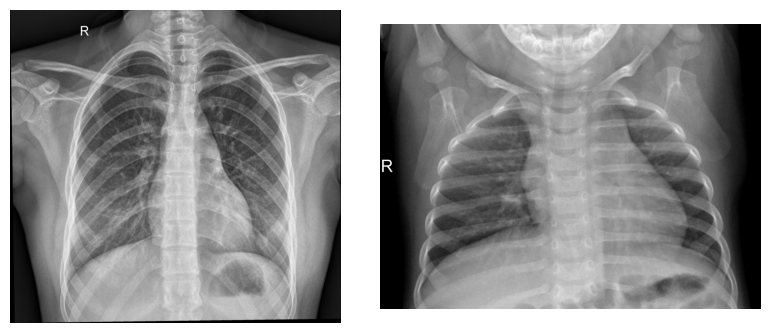

In [18]:
normal = os.listdir("working/train_dataset/NORMAL")
normal_dir = "working/train_dataset/NORMAL"
plt.figure(figsize=(12, 10))
for i in range(2):
    
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(normal_dir, normal[i]))
    print(img.shape)
    #plt.title("Normal")
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    #plt.imshow(img, cmap='gray')
    plt.axis('off')
plt.tight_layout()

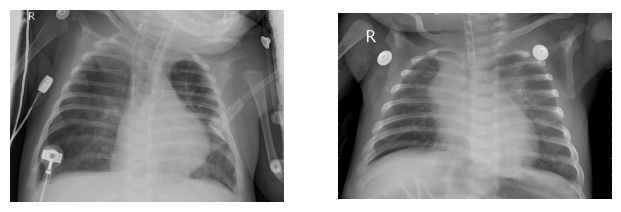

In [44]:
pneumonia = os.listdir("working/train_dataset/PNEUMONIA")
pneumonia_dir = "working/train_dataset/PNEUMONIA"

#plt.figure(figsize=(20, 10))
plt.figure(figsize=(12, 10))
for i in range(2):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(pneumonia_dir, pneumonia[i]))
    #plt.title("Neumonía")
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    #plt.imshow(img, cmap='gray')
    plt.axis('off')
    



Hay muy pocos datos en la particion de validacion(16), vamos a pasarle algunas imagenes de train a val para que podamos trabajar con una particion de val decente

In [21]:
training_images = tf.io.gfile.glob('chest_xray/train/*/*')
validation_images = tf.io.gfile.glob('chest_xray/val/*/*')

print(f'Before division of 80:20')
print(f'Total number of training images = {len(training_images)}')
print(f'Total number of validation images = {len(validation_images)}\n')


total_files = training_images
total_files.extend(validation_images)
print(f'Total number of images : training_images + validation_images = {len(total_files)}\n')

#lo partimos en 0.2 a val
train_images, val_images = train_test_split(total_files, test_size = 0.2 )
print(f'After division of 80:20')
print(f'Total number of training images = {len(train_images)}')
print(f'Total number of validation images = {len(val_images)}')

Before division of 80:20
Total number of training images = 5217
Total number of validation images = 16

Total number of images : training_images + validation_images = 5233

After division of 80:20
Total number of training images = 4186
Total number of validation images = 1047


Cambiar a python si no se tiene esos directorios para crear nuevos directorios con la particion de datos de train a val

for ele in train_images:
    parts_of_path = ele.split('/')

    if 'PNEUMONIA' == parts_of_path[-2]:
        tf.io.gfile.copy(src = ele, dst = 'working/train_dataset/PNEUMONIA/' +  parts_of_path[-1])
    else:
        tf.io.gfile.copy(src = ele, dst = 'working/train_dataset/NORMAL/' +  parts_of_path[-1])

for ele in val_images:
    parts_of_path = ele.split('/')

    if 'PNEUMONIA' == parts_of_path[-2]:
        tf.io.gfile.copy(src = ele, dst = 'working/val_dataset/PNEUMONIA/' +  parts_of_path[-1])
    else:
        tf.io.gfile.copy(src = ele, dst = 'working/val_dataset/NORMAL/' +  parts_of_path[-1])

In [22]:
data_dir_nueva = 'working'
train_dir = os.path.join(data_dir_nueva, 'train_dataset')
val_dir = os.path.join(data_dir_nueva, 'val_dataset')
test_dir = os.path.join(data_dir, 'test')

train_dir_downsampling = os.path.join('downsampling manual', 'train_dataset')
train_dir_oversampling = os.path.join('oversampling manual', 'train_dataset')

### Distribución de datos de la variable objetiva

<Axes: xlabel='etiqueta', ylabel='valor'>

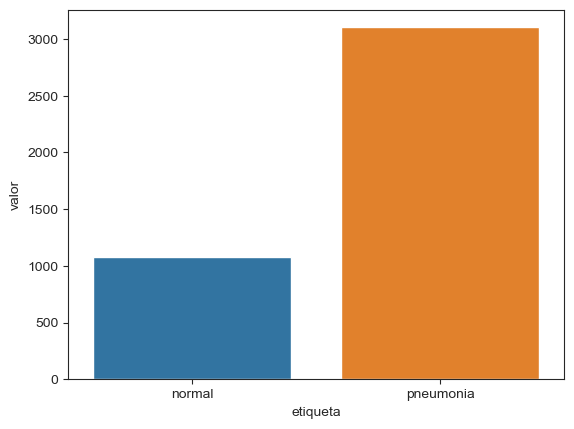

In [23]:
count_normal = len(os.listdir(os.path.join(train_dir, 'NORMAL')))

count_pneumonia = len(os.listdir(os.path.join(train_dir, 'PNEUMONIA')))

datafram_distribucion = [[count_normal, 'normal'], [count_pneumonia, 'pneumonia']]

# Crear el dataframe
df_dist = pd.DataFrame(datafram_distribucion, columns=['valor', 'etiqueta'])
sns.set_style('ticks')
sns.barplot(x='etiqueta', y='valor', data=df_dist)

268
780


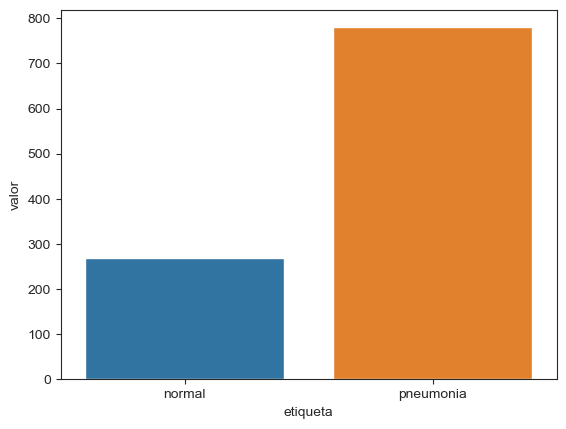

In [24]:
count_normal_val = len(os.listdir(os.path.join(val_dir, 'NORMAL')))

count_pneumonia_val = len(os.listdir(os.path.join(val_dir, 'PNEUMONIA')))
datafram_distribucion_val = [[count_normal_val, 'normal'], [count_pneumonia_val, 'pneumonia']]

df_dist_val = pd.DataFrame(datafram_distribucion_val, columns=['valor', 'etiqueta'])
sns.set_style('ticks')
sns.barplot(x='etiqueta', y='valor', data=df_dist_val)

print(count_normal_val)
print(count_pneumonia_val)

# Preprocesamiento de datos


Cargamos los datos usando la función image_dataset_from_directory(ahora usamos image.imagedatagenerator) para además de cargarlos poder hacer ciertos tratamientos sobre ellos.

data = tf.keras.utils.image_dataset_from_directory(train_dir,
                                                color_mode="rgb", 
                                                image_size=(256, 256))

Usamos un generador de imagenes para hacer ciertos procesos de data augmentation y preprocesamiento de nuestras imágenes iniciales.

In [25]:
##train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale = 1/255, # normalizacion
#                                                    rotation_range = 30, # rotacion de 30
#                                                    zoom_range = 0.2,
#                                                    width_shift_range = 0.1,
#                                                    height_shift_range = 0.1
#)

# Aumento de datos basados del articulo 
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2
)

train_datagen_sinaumento = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255)

Convertimos nuestras imágenes a tamaño de píxel 300x300 para agilizar el entrenamiento de los modelos y asignamos un tamaño de batch de 64 y le indicamos que es binaria

In [26]:
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size = (300,300),
    batch_size = 64 ,
    shuffle= True,
    class_mode = 'binary'
)

Found 4185 images belonging to 2 classes.


In [27]:
train_generator_downsampling = train_datagen.flow_from_directory(
    train_dir_downsampling,
    target_size = (300,300),
    batch_size = 64 ,
    shuffle= True,
    class_mode = 'binary'
)

Found 2438 images belonging to 2 classes.


In [28]:
train_generator_oversampling = train_datagen.flow_from_directory(
    train_dir_oversampling,
    target_size = (300,300),
    batch_size = 64 ,
    shuffle= True,
    class_mode = 'binary'
)

Found 5267 images belonging to 2 classes.


In [29]:
train_generator_oversampling2 = train_datagen.flow_from_directory(
    train_dir_oversampling,
    target_size = (224,224),
    batch_size = 64 ,
    shuffle= True,
    class_mode = 'binary'
)

Found 5267 images belonging to 2 classes.


In [30]:
train_generator

In [31]:
print(len(train_generator_downsampling.classes[train_generator_downsampling.classes==0]))
print(len(train_generator_downsampling.classes[train_generator_downsampling.classes==1]))

1082
1356


In [32]:
print(len(train_generator_oversampling.classes[train_generator_oversampling.classes==0]))
print(len(train_generator_oversampling.classes[train_generator_oversampling.classes==1]))

2164
3103


In [33]:
print(len(train_generator.classes[train_generator.classes==0]))
print(len(train_generator.classes[train_generator.classes==1]))

1082
3103


In [34]:
batch_buena= train_generator.next()

In [141]:
batch_oversampled= train_generator_oversampling.next()

In [142]:
images_oversampled = batch_oversampled[0]
labels_oversampled = batch_oversampled[1]

In [143]:
labels_oversampled

array([0., 0., 1., 0., 1., 0., 0., 1., 0., 1., 1., 1., 0., 1., 1., 0., 1.,
       0., 0., 1., 0., 0., 1., 1., 1., 0., 0., 0., 1., 1., 1., 1., 1., 1.,
       0., 1., 0., 0., 1., 1., 1., 0., 1., 1., 0., 1., 0., 1., 1., 1., 0.,
       0., 0., 1., 0., 1., 1., 0., 1., 0., 1., 1., 0., 1.], dtype=float32)

In [144]:
len(labels_oversampled[labels_oversampled==0])

28

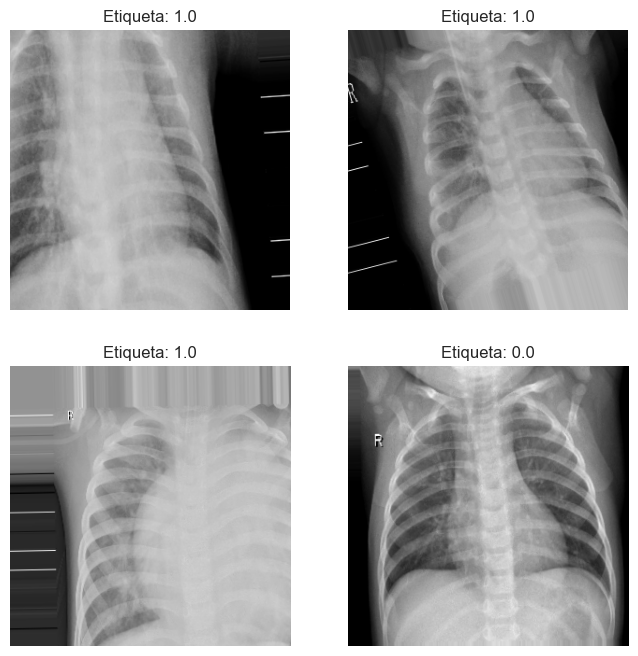

In [145]:
#nueva
fig, axs = plt.subplots(2, 2, figsize=(8, 8))
axs = axs.flatten()
j= 9
for i, img in enumerate(images_oversampled[9:13]):
    img= img*255
    axs[i].imshow(img.astype(np.uint8))
    axs[i].set_title('Etiqueta: {}'.format(labels_oversampled[j]))
    axs[i].axis('off')
    j+=1

In [794]:
images = batch_buena[0]
labels = batch_buena[1]

In [795]:
labels

array([0., 1., 1., 1., 1., 1., 1., 0., 1., 1., 1., 0., 0., 1., 1., 0., 1.,
       1., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 1., 1., 0., 1., 1.,
       1., 0., 1., 1., 1., 0., 1., 1., 0., 1., 1., 1., 0., 1., 1., 1., 1.,
       0., 1., 0., 0., 1., 1., 1., 1., 0., 1., 0., 0., 1.], dtype=float32)

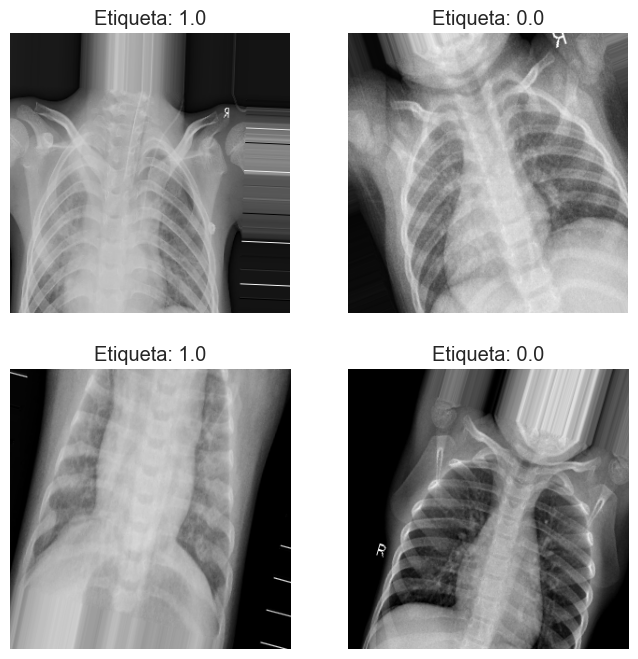

In [781]:
#nueva
fig, axs = plt.subplots(2, 2, figsize=(8, 8))
axs = axs.flatten()
j= 30
for i, img in enumerate(images[30:34]):
    img= img*255
    axs[i].imshow(img.astype(np.uint8))
    axs[i].set_title('Etiqueta: {}'.format(labels[j]))
    axs[i].axis('off')
    j+=1

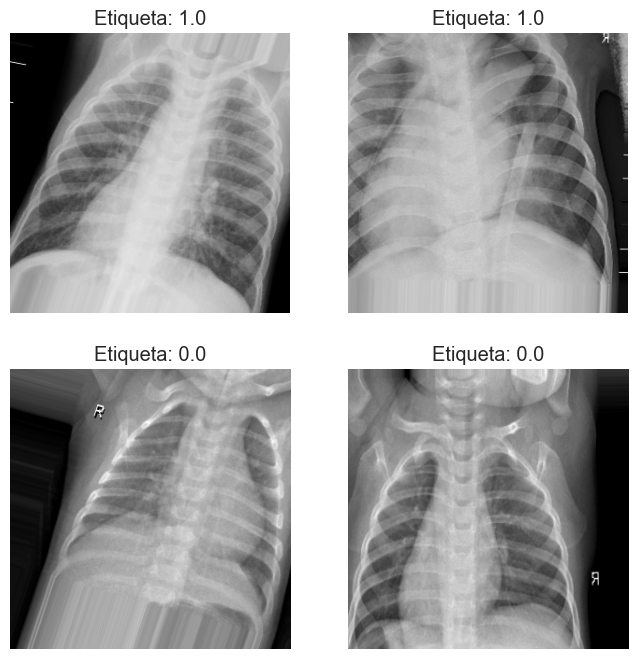

In [782]:
fig, axs = plt.subplots(2, 2, figsize=(8, 8))
axs = axs.flatten()
for i, img in enumerate(images[:4]):
    img= img*255
    axs[i].imshow(img.astype(np.uint8))
    axs[i].set_title('Etiqueta: {}'.format(labels[i]))
    axs[i].axis('off')

0 = NORMAL
1 = PNEUMONIA

## Normalización de datos

Dividimos el valor de cada pixel en 255 por lo que convertimos el rango de 0-255 a 0-1 para mejorar la eficiencia a la hora de pasarlos a nuestros modelos de machine learning

Confirmamos que hemos hecho bien la normalización del valor de nuestros píxeles.

In [18]:
print(train_generator.next()[0].min())
train_generator.next()[0].max()

0.0


1.0

## Partición de datos

En nuestro caso ya tenemos los datos particionados en diferentes carpetas por lo que las utilizaremos directamente.

Lo que debemos de tener en cuenta es que no debemos usar el mismo generador de imagenes de train para datos de validacion y test.

La función crea batch de 64 pero en la vida real no procesamos las imágenes en batch en el mismo tiempo, sino que van de una en una, por lo que cambiamos ese parámetro a 1.

El valor por defecto de shuffle es "True", pero para caso de validación y test tampoco necesitamos tener los datos mezclados así que lo cambiamos a false.

In [35]:
val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale = 1/255)


In [36]:
validation_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size = (300,300),
    batch_size = 64 ,
    class_mode = 'binary',
    shuffle= True
)

Found 1047 images belonging to 2 classes.


In [37]:
print(len(validation_generator.classes[validation_generator.classes==0]))
print(len(validation_generator.classes[validation_generator.classes==1]))

267
780


In [38]:
test_generator = val_datagen.flow_from_directory(
    test_dir,
    target_size = (300,300),
    batch_size = 1 ,
    class_mode = 'binary',
    shuffle=False
)

Found 624 images belonging to 2 classes.


In [39]:
test_generator2 = val_datagen.flow_from_directory(
    test_dir,
    target_size = (224,224),
    batch_size = 1 ,
    class_mode = 'binary',
    shuffle=False
)

Found 624 images belonging to 2 classes.


# Corregir pesos debidos a datos imbalanceados

In [40]:
initial_bias = np.log([count_pneumonia/count_normal])
initial_bias

array([1.05355821])

In [43]:
weight_for_0 = (1 / count_normal)*(len(train_images))/2.0 
weight_for_1 = (1 / count_pneumonia)*(len(train_images))/2.0

class_weight = {0: weight_for_0, 1: weight_for_1}

print('Peso para la clase 0: {:.2f}'.format(weight_for_0))
print('Peso para la clase 1: {:.2f}'.format(weight_for_1))

Peso para la clase 0: 1.93
Peso para la clase 1: 0.67


In [44]:
count_normal_oversampled = len(os.listdir(os.path.join(train_dir_oversampling, 'NORMAL')))

count_pneumonia_oversampled = len(os.listdir(os.path.join(train_dir_oversampling, 'PNEUMONIA')))

weight_for_0_oversampled = (1 / count_normal_oversampled)*(5269)/2.0 
weight_for_1_oversampled = (1 / count_pneumonia_oversampled)*(5269)/2.0

class_weight_oversampled = {0: weight_for_0_oversampled, 1: weight_for_0_oversampled}

print('Peso para la clase 0: {:.2f}'.format(weight_for_0_oversampled))
print('Peso para la clase 1: {:.2f}'.format(weight_for_1_oversampled))



Peso para la clase 0: 1.22
Peso para la clase 1: 0.85


In [45]:
len(train_images)


4186

# Implementación de modelos

#### Modelos nuevos creados

Modelo1


In [159]:
modelo_propio1= Sequential()

In [160]:
modelo_propio1.add(Conv2D(filters=16, kernel_size = (3,3), activation=tf.nn.relu , input_shape=(300,300,3) ))
modelo_propio1.add(MaxPooling2D())
modelo_propio1.add(Flatten())
modelo_propio1.add(Dense(1, activation='sigmoid'))

modelo_propio1.add(Conv2D(16,(3,3), 1 ,input_shape=(256,256,1), activation='relu'))
modelo_propio1.add(MaxPooling2D())

modelo_propio1.add(Conv2D(32,(3,3), 1 , activation='relu'))
modelo_propio1.add(MaxPooling2D())

modelo_propio1.add(Conv2D(16,(3,3), 1 , activation='relu'))

modelo_propio1.add(Flatten())

modelo_propio1.add(Dense(256, activation='relu'))
modelo_propio1.add(Dense(1, activation='sigmoid'))

In [161]:
modelo_propio1.compile(
        tf.keras.optimizers.Adam(learning_rate=0.001),
        loss=tf.losses.BinaryCrossentropy(),
        metrics=['accuracy', tf.keras.metrics.Precision(name='precision'),tf.keras.metrics.Recall(name='recall')])

In [163]:
modelo_propio1.save('modelos_vista/propio1.h5')

In [151]:
modelo_propio1.summary()

Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_49 (Conv2D)          (None, 298, 298, 16)      448       
                                                                 
 max_pooling2d_28 (MaxPoolin  (None, 149, 149, 16)     0         
 g2D)                                                            
                                                                 
 flatten_12 (Flatten)        (None, 355216)            0         
                                                                 
 dense_43 (Dense)            (None, 1)                 355217    
                                                                 
Total params: 355,665
Trainable params: 355,665
Non-trainable params: 0
_________________________________________________________________


In [152]:
checkpoint_propio1 = tf.keras.callbacks.ModelCheckpoint('modelos/model_propio1.h5', save_best_only= True)
early_stopping_propio1 = tf.keras.callbacks.EarlyStopping(monitor ='val_loss', patience=20, mode = 'min',restore_best_weights=True)
tensorboard_callback_propio1 = tf.keras.callbacks.TensorBoard(log_dir='logs/propio1')

Modelo 2

In [575]:
# Modelo 2

modelo_propio2 = Sequential()

modelo_propio2.add(Conv2D(filters=32, kernel_size=(3, 3), input_shape=(300, 300, 3), activation='relu'))
#modelo_propio2.add(BatchNormalization())
modelo_propio2.add(Conv2D(filters=32, kernel_size=(3, 3), activation='relu'))
#modelo_propio2.add(BatchNormalization())
modelo_propio2.add(MaxPooling2D(pool_size=(2, 2)))

modelo_propio2.add(Conv2D(filters=64, kernel_size=(3, 3), activation='relu'))
#modelo_propio2.add(BatchNormalization())
modelo_propio2.add(Conv2D(filters=64, kernel_size=(3, 3), activation='relu'))
#modelo_propio2.add(BatchNormalization())
modelo_propio2.add(MaxPooling2D(pool_size=(2, 2)))

modelo_propio2.add(Conv2D(filters=128, kernel_size=(3, 3), activation='relu'))
#modelo_propio2.add(BatchNormalization())
modelo_propio2.add(Conv2D(filters=128, kernel_size=(3, 3), activation='relu'))
#modelo_propio2.add(BatchNormalization())
modelo_propio2.add(MaxPooling2D(pool_size=(2, 2)))
modelo_propio2.add(Flatten())
#modelo_propio2.add(GlobalAveragePooling2D())
modelo_propio2.add(Dense(128, activation='relu'))
modelo_propio2.add(Dropout(0.2))

modelo_propio2.add(Dense(1, activation='sigmoid'))

modelo_propio2.compile(loss=tf.losses.BinaryCrossentropy(), 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), 
              metrics=['accuracy', tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall')])


In [572]:
modelo_propio2.summary()

Model: "sequential_62"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_569 (Conv2D)         (None, 298, 298, 32)      896       
                                                                 
 conv2d_570 (Conv2D)         (None, 296, 296, 32)      9248      
                                                                 
 max_pooling2d_84 (MaxPoolin  (None, 148, 148, 32)     0         
 g2D)                                                            
                                                                 
 conv2d_571 (Conv2D)         (None, 146, 146, 64)      18496     
                                                                 
 conv2d_572 (Conv2D)         (None, 144, 144, 64)      36928     
                                                                 
 max_pooling2d_85 (MaxPoolin  (None, 72, 72, 64)       0         
 g2D)                                                

In [576]:
modelo_propio2.save('modelo_vista/propio3.h5')

In [124]:
checkpoint_propio2 = tf.keras.callbacks.ModelCheckpoint('modelos/model_propio2.h5', save_best_only= True)
early_stopping_propio2 = tf.keras.callbacks.EarlyStopping(monitor ='val_loss', patience=7, mode = 'min',restore_best_weights=True)
tensorboard_callback_propio2 = tf.keras.callbacks.TensorBoard(log_dir='logs/propio2')

##### Modelo 3

In [197]:
# Modelo 2

modelo_propio3 = Sequential()

modelo_propio3.add(Conv2D(filters=16, kernel_size=(5, 5), input_shape=(300, 300, 3), activation='relu'))
modelo_propio3.add(MaxPooling2D(pool_size=(3, 3)))

modelo_propio3.add(Conv2D(filters=32, kernel_size=(5, 5), activation='relu'))
#modelo_propio3.add(MaxPooling2D(pool_size=(3, 3)))

modelo_propio3.add(Flatten())
modelo_propio3.add(Dropout(0.2))
modelo_propio3.add(Dense(256, activation='relu'))


modelo_propio3.add(Dense(1, activation='sigmoid'))

modelo_propio3.compile(loss=tf.losses.BinaryCrossentropy(), 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), 
              metrics=['accuracy', tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall')])


In [574]:
modelo_propio3.save('modelo_vista/propio2.h5')

In [573]:
modelo_propio3.summary()

Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_97 (Conv2D)          (None, 296, 296, 16)      1216      
                                                                 
 max_pooling2d_63 (MaxPoolin  (None, 98, 98, 16)       0         
 g2D)                                                            
                                                                 
 conv2d_98 (Conv2D)          (None, 94, 94, 32)        12832     
                                                                 
 flatten_20 (Flatten)        (None, 282752)            0         
                                                                 
 dropout_31 (Dropout)        (None, 282752)            0         
                                                                 
 dense_75 (Dense)            (None, 256)               72384768  
                                                     

#### Modelos preentrenados


##### InceptionV3

Con peso asignado de imagenet

In [280]:
inceptionv3_modelo_imagenet_base = tf.keras.applications.InceptionV3(weights='imagenet',
                                                       include_top=False,
                                                       input_shape=(300,300,3))

for layers in inceptionv3_modelo_imagenet_base.layers[:200]:
    layers.trainable = False

In [281]:
inceptionv3_modelo_imagenet = tf.keras.Sequential([
        inceptionv3_modelo_imagenet_base,
        tf.keras.layers.GlobalAveragePooling2D(),
        tf.keras.layers.Dense(1,activation=tf.nn.sigmoid) 
        ])

In [282]:
inceptionv3_modelo_imagenet.compile(
    loss='binary_crossentropy', 
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), 
    metrics= ['accuracy', tf.keras.metrics.Precision(name='precision'),
            tf.keras.metrics.Recall(name='recall')])

In [272]:
inceptionv3_modelo_imagenet.summary()

Model: "sequential_50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 8, 8, 2048)        21802784  
                                                                 
 global_average_pooling2d_21  (None, 2048)             0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_104 (Dense)           (None, 1)                 2049      
                                                                 
Total params: 21,804,833
Trainable params: 14,806,337
Non-trainable params: 6,998,496
_________________________________________________________________


In [259]:
checkpoint_inception = tf.keras.callbacks.ModelCheckpoint("modelos/model_inception.h5", save_best_only= True)

In [260]:
early_stopping_inception = tf.keras.callbacks.EarlyStopping(monitor ='val_loss', patience=20, mode = 'min',restore_best_weights=True)

In [68]:
tensorboard_callback_inception = tf.keras.callbacks.TensorBoard(log_dir='logs/inception')

##### ResNet50 

In [51]:
resnet50_modelo_base = tf.keras.applications.ResNet50V2(weights='imagenet',
                                                    include_top=False,
                                                    input_shape=(300,300,3))

#for layers in resnet50_modelo_base.layers:
#    layers.trainable = False

resnet50_modelo_base.trainable = False

In [52]:
resnet50_modelo = tf.keras.Sequential([
        resnet50_modelo_base,
        #tf.keras.layers.GlobalAveragePooling2D(),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(512, activation=tf.nn.relu),
        tf.keras.layers.Dropout(0.2),
        tf.keras.layers.Dense(512, activation=tf.nn.relu),
        tf.keras.layers.Dropout(0.2),
        tf.keras.layers.Dense(1, activation=tf.nn.sigmoid),
        ])

In [53]:
resnet50_modelo.compile(
    loss='binary_crossentropy',
    optimizer= tf.keras.optimizers.Adam(learning_rate=0.001), 
    metrics= ['accuracy', tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall')])

In [210]:
resnet50_modelo.summary()


Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50v2 (Functional)     (None, 10, 10, 2048)      23564800  
                                                                 
 flatten_7 (Flatten)         (None, 204800)            0         
                                                                 
 dense_8 (Dense)             (None, 512)               104858112 
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_9 (Dense)             (None, 512)               262656    
                                                                 
 dropout_2 (Dropout)         (None, 512)               0         
                                                                 
 dense_10 (Dense)            (None, 1)                

In [73]:
checkpoint_resnet = tf.keras.callbacks.ModelCheckpoint("modelos/model_resnet.h5", save_best_only= True)

In [55]:
early_stopping_resnet = tf.keras.callbacks.EarlyStopping(monitor ='val_loss', patience=20, mode = 'min',restore_best_weights=True)

In [75]:
tensorboard_callback_resnet = tf.keras.callbacks.TensorBoard(log_dir='logs/resnet')

In [76]:
lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',
                                          patience=8)

##### VGG16

Usamos la función de VGG16 para crear 

In [69]:
vgg16_base = tf.keras.applications.VGG16(weights='imagenet',
                                           include_top=False,
                                           input_shape=(300,300,3))

vgg16_base.trainable = False

In [70]:
vgg16_modelo = tf.keras.Sequential([
        vgg16_base,
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(512, activation=tf.nn.relu),
        tf.keras.layers.Dropout(0.2),
        tf.keras.layers.Dense(512, activation=tf.nn.relu),
        tf.keras.layers.Dropout(0.2),
        tf.keras.layers.Dense(1,activation=tf.nn.sigmoid)
        ])


vgg16_modelo.compile(
        loss='binary_crossentropy',
        optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), 
        metrics= ['accuracy', tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall')])

vgg16_modelo.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 9, 9, 512)         14714688  
                                                                 
 flatten_7 (Flatten)         (None, 41472)             0         
                                                                 
 dense_23 (Dense)            (None, 512)               21234176  
                                                                 
 dropout_10 (Dropout)        (None, 512)               0         
                                                                 
 dense_24 (Dense)            (None, 512)               262656    
                                                                 
 dropout_11 (Dropout)        (None, 512)               0         
                                                                 
 dense_25 (Dense)            (None, 1)                

En caso de aplicar early stopping:

In [71]:
checkpoint_vgg = tf.keras.callbacks.ModelCheckpoint("modelos/model_vgg.h5", save_best_only= True)
early_stopping_vgg = tf.keras.callbacks.EarlyStopping(monitor ='val_loss', patience=20, mode = 'min',restore_best_weights=True)
tensorboard_callback_vgg = tf.keras.callbacks.TensorBoard(log_dir='logs/vgg')

##### Efficientnet

In [313]:
efficientenet_base = tf.keras.applications.EfficientNetB0(
    include_top= False,
    weights= 'imagenet', 
    input_shape= (300,300,3)
)

efficientenet_base.trainable = False

16705208/16705208 [==============================] - 1s 0us/step


In [315]:
#class_count = len(list(train_generator.class_indices.keys())) # to define number of classes in dense layer


efficientenet_model = tf.keras.Sequential([
    efficientenet_base,
    
    tf.keras.layers.GlobalAveragePooling2D(),
    #tf.keras.layers.Flatten(),
    #tf.keras.layers.Dropout(0.2),
    #tf.keras.layers.Dense(64, activation= tf.nn.relu),
    
    #tf.keras.layers.Dense(32, activation = tf.nn.relu),
    #tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(1, activation= tf.nn.sigmoid)
    
])

efficientenet_model.compile(
    optimizer = tf.keras.optimizers.Adam(learning_rate=0.001), 
    loss='binary_crossentropy', 
    metrics= ['accuracy',tf.keras.metrics.Precision(name='precision'),tf.keras.metrics.Recall(name='recall')]
)
### Esto es un metodo de rmsprop literal 
efficientenet_model.summary()

Model: "sequential_60"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetb0 (Functional)  (None, 10, 10, 1280)     4049571   
                                                                 
 global_average_pooling2d_31  (None, 1280)             0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_114 (Dense)           (None, 1)                 1281      
                                                                 
Total params: 4,050,852
Trainable params: 1,281
Non-trainable params: 4,049,571
_________________________________________________________________


In [248]:
modelo_eff = tf.keras.applications.EfficientNetB4(weights = 'imagenet', 
                           include_top = False, 
                           input_shape = (224, 224, 3))

## Output layer
x = modelo_eff.output
x = GlobalAveragePooling2D()(x)
x = Dense(64, activation="relu")(x)
x = Dense(32, activation="relu")(x)
predictions = Dense(1, activation="sigmoid")(x)
## Compile and run
modelo_eff = Model(inputs=modelo_eff.input, outputs=predictions)

modelo_eff.compile(optimizer='adam',
              loss='binary_crossentropy', 
              metrics=['accuracy', tf.keras.metrics.Precision(name='precision'),tf.keras.metrics.Recall(name='recall')])




In [237]:
checkpoint_efficientnet = tf.keras.callbacks.ModelCheckpoint("modelos/model_efficientnet.h5", save_best_only= True)

In [235]:
early_stopping_efficientnet = tf.keras.callbacks.EarlyStopping(monitor ='val_loss', patience=7, mode = 'min',restore_best_weights=True)

In [84]:
tensorboard_callback_efficientnet = tf.keras.callbacks.TensorBoard(log_dir='logs/efficientnet')

In [246]:
rlr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', 
                        factor=0.3, 
                        patience=3, 
                        min_lr=0.000001, 
                        verbose=1)

##### Mobilenet

In [464]:
mobilenet_modelo = tf.keras.Sequential([
        base_model_mobil,
        tf.keras.layers.GlobalAveragePooling2D(),
        tf.keras.layers.Dense(1,activation=tf.nn.sigmoid)
        ])

In [465]:
mobilenet_modelo.save('modelo_vista/mobilenet_bueno.h5')

In [323]:
base_model_mobil = tf.keras.applications.MobileNet(weights='imagenet', include_top=False, input_shape=(224, 224, 3)) 

x = base_model_mobil.output

# Add a global spatial average pooling layer
x = GlobalAveragePooling2D()(x)

# Add a logistic layer
predictions = Dense(1, activation="sigmoid")(x)

model_mobil = Model(inputs=base_model_mobil.input, outputs=predictions)
# Compile model
model_mobil.compile(optimizer='adam', loss = 'binary_crossentropy',
                           metrics = ['binary_accuracy', 'mae'])

In [537]:
print(len(modelo_propio1.layers))
print(len(modelo_propio2.layers))
print(len(modelo_propio3.layers))
print(len(vgg16_modelo.layers))
print(len(resnet50_modelo.layers))



4
13
7
7
7


In [532]:
len(model_mobil.layers)

88

In [524]:
model_mobil.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_32 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 112, 112, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 112, 112, 32)     128       
 ation)                                                    

In [461]:
model_mobil.save('modelo_vista/mobilenet.h5')

# Entrenamiento


En caso de poner alguna semilla para que no varie el modelo

In [86]:
# Semilla 
tf.random.set_seed(
    12345
)

## Modelo Secuencial Propios

In [324]:
model_mobil_trained = model_mobil.fit(
    train_generator_oversampling,
        steps_per_epoch = 10,
        epochs=20, 
        validation_data=validation_generator,
        #callbacks=[early_stopping_propio1],
        class_weight=class_weight_oversampled,
        verbose=1
)

Epoch 1/20


2023-06-22 20:27:40.517220: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - ETA: 0s - loss: 0.4141 - binary_accuracy: 0.8422 - mae: 0.1662

2023-06-22 20:28:48.928243: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - 128s 7s/step - loss: 0.4141 - binary_accuracy: 0.8422 - mae: 0.1662 - val_loss: 0.2652 - val_binary_accuracy: 0.8892 - val_mae: 0.1416
Epoch 2/20
10/10 [==============================] - 40s 4s/step - loss: 0.2053 - binary_accuracy: 0.9453 - mae: 0.0666 - val_loss: 1.2355 - val_binary_accuracy: 0.7240 - val_mae: 0.2817
Epoch 3/20
10/10 [==============================] - 33s 3s/step - loss: 0.2353 - binary_accuracy: 0.9469 - mae: 0.0633 - val_loss: 9.1138 - val_binary_accuracy: 0.2646 - val_mae: 0.7310
Epoch 4/20
10/10 [==============================] - 36s 4s/step - loss: 0.1857 - binary_accuracy: 0.9469 - mae: 0.0644 - val_loss: 0.2868 - val_binary_accuracy: 0.9169 - val_mae: 0.0960
Epoch 5/20
10/10 [==============================] - 31s 3s/step - loss: 0.1423 - binary_accuracy: 0.9531 - mae: 0.0515 - val_loss: 0.2586 - val_binary_accuracy: 0.9245 - val_mae: 0.0838
Epoch 6/20
10/10 [==============================] - 32s 3s/step - loss: 0.1361 -

### Modelo Propio 1

In [162]:
modelo_propio1_trained = modelo_propio1.fit(
        train_generator_oversampling,
        steps_per_epoch = 32,
        epochs=20, 
        validation_data=validation_generator,
        callbacks=[early_stopping_propio1],
        class_weight=class_weight_oversampled,
        verbose=1
)


Epoch 1/20


2023-06-21 16:50:15.190488: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


32/32 [==============================] - ETA: 0s - loss: 2.6324 - accuracy: 0.5552 - precision: 0.6061 - recall: 0.6825

2023-06-21 16:51:21.978681: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


32/32 [==============================] - 78s 2s/step - loss: 2.6324 - accuracy: 0.5552 - precision: 0.6061 - recall: 0.6825 - val_loss: 0.5623 - val_accuracy: 0.7908 - val_precision: 0.8000 - val_recall: 0.9590
Epoch 2/20
32/32 [==============================] - 73s 2s/step - loss: 0.6180 - accuracy: 0.7673 - precision: 0.7911 - recall: 0.8129 - val_loss: 0.4236 - val_accuracy: 0.8290 - val_precision: 0.9465 - val_recall: 0.8167
Epoch 3/20
32/32 [==============================] - 74s 2s/step - loss: 0.4837 - accuracy: 0.8589 - precision: 0.9154 - recall: 0.8433 - val_loss: 0.3530 - val_accuracy: 0.8691 - val_precision: 0.9879 - val_recall: 0.8346
Epoch 4/20
32/32 [==============================] - 73s 2s/step - loss: 0.4455 - accuracy: 0.8677 - precision: 0.9082 - recall: 0.8695 - val_loss: 0.2681 - val_accuracy: 0.9045 - val_precision: 0.9816 - val_recall: 0.8885
Epoch 5/20
32/32 [==============================] - 75s 2s/step - loss: 0.4270 - accuracy: 0.8623 - precision: 0.9024 - rec

### Modelo Propio 2

In [173]:
modelo_propio2_trained = modelo_propio2.fit(
        train_generator_oversampling,
        steps_per_epoch = 32,
        epochs=20, 
        validation_data=validation_generator,
        class_weight=class_weight_oversampled,
        callbacks=[early_stopping_propio2]
)


Epoch 1/20


2023-06-21 18:07:17.868708: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


32/32 [==============================] - ETA: 0s - loss: 0.7782 - accuracy: 0.6694 - precision: 0.6567 - recall: 0.9142

2023-06-21 18:08:28.897123: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


32/32 [==============================] - 84s 2s/step - loss: 0.7782 - accuracy: 0.6694 - precision: 0.6567 - recall: 0.9142 - val_loss: 0.4926 - val_accuracy: 0.7947 - val_precision: 0.8149 - val_recall: 0.9372
Epoch 2/20
32/32 [==============================] - 77s 2s/step - loss: 0.4774 - accuracy: 0.8398 - precision: 0.8795 - recall: 0.8430 - val_loss: 0.4560 - val_accuracy: 0.7870 - val_precision: 0.9912 - val_recall: 0.7205
Epoch 3/20
32/32 [==============================] - 77s 2s/step - loss: 0.4250 - accuracy: 0.8647 - precision: 0.9211 - recall: 0.8425 - val_loss: 0.4271 - val_accuracy: 0.7899 - val_precision: 0.9947 - val_recall: 0.7218
Epoch 4/20
32/32 [==============================] - 77s 2s/step - loss: 0.4098 - accuracy: 0.8706 - precision: 0.9159 - recall: 0.8589 - val_loss: 0.3555 - val_accuracy: 0.8376 - val_precision: 0.9872 - val_recall: 0.7923
Epoch 5/20
32/32 [==============================] - 77s 2s/step - loss: 0.3969 - accuracy: 0.8809 - precision: 0.9255 - rec

### Modelo Propio 3

In [198]:
modelo_propio3_trained = modelo_propio3.fit(
        train_generator_oversampling,
        steps_per_epoch = 32,
        epochs=20, 
        validation_data=validation_generator,
        class_weight=class_weight_oversampled,
        callbacks=[early_stopping_propio2]
)

Epoch 1/20


2023-06-21 19:28:02.890323: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


32/32 [==============================] - ETA: 0s - loss: 1.8686 - accuracy: 0.6715 - precision: 0.7076 - recall: 0.7309

2023-06-21 19:29:11.155358: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


32/32 [==============================] - 81s 2s/step - loss: 1.8686 - accuracy: 0.6715 - precision: 0.7076 - recall: 0.7309 - val_loss: 0.4544 - val_accuracy: 0.7927 - val_precision: 0.8768 - val_recall: 0.8397
Epoch 2/20
32/32 [==============================] - 76s 2s/step - loss: 0.5611 - accuracy: 0.7798 - precision: 0.8168 - recall: 0.8134 - val_loss: 0.5597 - val_accuracy: 0.6800 - val_precision: 0.9764 - val_recall: 0.5846
Epoch 3/20
32/32 [==============================] - 76s 2s/step - loss: 0.5907 - accuracy: 0.7759 - precision: 0.7928 - recall: 0.8308 - val_loss: 0.5805 - val_accuracy: 0.7698 - val_precision: 0.8468 - val_recall: 0.8436
Epoch 4/20
32/32 [==============================] - 76s 2s/step - loss: 0.5899 - accuracy: 0.8062 - precision: 0.8622 - recall: 0.8070 - val_loss: 0.6018 - val_accuracy: 0.7096 - val_precision: 0.8400 - val_recall: 0.7538
Epoch 5/20
32/32 [==============================] - 76s 2s/step - loss: 0.5110 - accuracy: 0.8320 - precision: 0.8824 - rec

## Modelos prentrenados

### InceptionV3

In [283]:
inceptionv3_modelo_imagenet_trained2 = inceptionv3_modelo_imagenet.fit(
    train_generator_oversampling,
    epochs=35, 
    steps_per_epoch= 10,
    validation_data=validation_generator, 
    class_weight= class_weight_oversampled,
    callbacks=[checkpoint_inception, early_stopping_inception])

Epoch 1/35


2023-06-22 18:58:01.991616: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - ETA: 0s - loss: 0.4236 - accuracy: 0.8706 - precision: 0.9273 - recall: 0.8524

2023-06-22 18:59:22.056330: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - 141s 12s/step - loss: 0.4236 - accuracy: 0.8706 - precision: 0.9273 - recall: 0.8524 - val_loss: 0.6271 - val_accuracy: 0.6399 - val_precision: 0.9975 - val_recall: 0.5179
Epoch 2/35
10/10 [==============================] - 46s 5s/step - loss: 0.2016 - accuracy: 0.9359 - precision: 0.9528 - recall: 0.9346 - val_loss: 0.6225 - val_accuracy: 0.7106 - val_precision: 1.0000 - val_recall: 0.6115
Epoch 3/35
10/10 [==============================] - 34s 3s/step - loss: 0.1672 - accuracy: 0.9516 - precision: 0.9631 - recall: 0.9555 - val_loss: 0.5162 - val_accuracy: 0.7689 - val_precision: 1.0000 - val_recall: 0.6897
Epoch 4/35
10/10 [==============================] - 32s 3s/step - loss: 0.1550 - accuracy: 0.9531 - precision: 0.9555 - recall: 0.9656 - val_loss: 0.4856 - val_accuracy: 0.8013 - val_precision: 1.0000 - val_recall: 0.7333
Epoch 5/35
10/10 [==============================] - 33s 3s/step - loss: 0.1488 - accuracy: 0.9563 - precision: 0.9734 - r

In [61]:
inceptionv3_modelo_imagenet_trained = inceptionv3_modelo_imagenet.fit(
    train_generator,
    epochs=35, 
    steps_per_epoch= 10,
    validation_data=validation_generator, 
    class_weight= class_weight,
    callbacks=[checkpoint_inception, early_stopping_inception, tensorboard_callback_inception])

Epoch 1/35


2023-04-24 11:51:19.687365: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - ETA: 0s - loss: 0.4657 - accuracy: 0.7969 - precision: 0.9050 - recall: 0.8197

2023-04-24 11:51:32.577095: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - 86s 8s/step - loss: 0.4657 - accuracy: 0.7969 - precision: 0.9050 - recall: 0.8197 - val_loss: 6.6713 - val_accuracy: 0.7450 - val_precision: 0.7450 - val_recall: 1.0000
Epoch 2/35
10/10 [==============================] - 75s 8s/step - loss: 0.1808 - accuracy: 0.9062 - precision: 0.9635 - recall: 0.9056 - val_loss: 4.0670 - val_accuracy: 0.7431 - val_precision: 0.9981 - val_recall: 0.6564
Epoch 3/35
10/10 [==============================] - 75s 8s/step - loss: 0.1806 - accuracy: 0.9187 - precision: 0.9676 - recall: 0.9167 - val_loss: 2.0466 - val_accuracy: 0.7717 - val_precision: 0.9963 - val_recall: 0.6962
Epoch 4/35
10/10 [==============================] - 73s 8s/step - loss: 0.1571 - accuracy: 0.9219 - precision: 0.9773 - recall: 0.9149 - val_loss: 6.0504 - val_accuracy: 0.7373 - val_precision: 0.9941 - val_recall: 0.6513
Epoch 5/35
10/10 [==============================] - 75s 8s/step - loss: 0.1216 - accuracy: 0.9312 - precision: 0.9769 - rec

### Resnet50

In [ ]:
resnet50_modelo_trained  = resnet50_modelo.fit(
    train_generator,
    steps_per_epoch=100,
    epochs=30,
    validation_data=validation_generator, 
    class_weight= class_weight,
    callbacks=[checkpoint_resnet, early_stopping_resnet, tensorboard_callback_resnet, lr])


In [56]:
resnet50_modelo_trained2  = resnet50_modelo.fit(
    train_generator_oversampling,
    steps_per_epoch=10,
    epochs=20,
    validation_data=validation_generator, 
    class_weight= class_weight_oversampled,
    callbacks=[early_stopping_resnet])


Epoch 1/20


2023-06-20 17:29:17.879006: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - ETA: 0s - loss: 19.0319 - accuracy: 0.6422 - precision: 0.6958 - recall: 0.6976

2023-06-20 17:29:43.923787: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - 54s 5s/step - loss: 19.0319 - accuracy: 0.6422 - precision: 0.6958 - recall: 0.6976 - val_loss: 0.8399 - val_accuracy: 0.9207 - val_precision: 0.9235 - val_recall: 0.9744
Epoch 2/20
10/10 [==============================] - 35s 3s/step - loss: 3.4050 - accuracy: 0.8813 - precision: 0.9077 - recall: 0.8985 - val_loss: 1.1861 - val_accuracy: 0.9035 - val_precision: 0.9942 - val_recall: 0.8756
Epoch 3/20
10/10 [==============================] - 34s 3s/step - loss: 1.6497 - accuracy: 0.8703 - precision: 0.8955 - recall: 0.8978 - val_loss: 0.4148 - val_accuracy: 0.9179 - val_precision: 0.9860 - val_recall: 0.9026
Epoch 4/20
10/10 [==============================] - 32s 3s/step - loss: 1.3206 - accuracy: 0.8766 - precision: 0.8982 - recall: 0.8958 - val_loss: 0.6489 - val_accuracy: 0.9064 - val_precision: 0.9942 - val_recall: 0.8795
Epoch 5/20
10/10 [==============================] - 32s 3s/step - loss: 1.1044 - accuracy: 0.9047 - precision: 0.9119 - re

### VGG16

In [ ]:
vgg16_modelo_trained = vgg16_modelo.fit(
    train_generator,
    steps_per_epoch=10,
    epochs=20,
    validation_data=validation_generator,
    class_weight= class_weight,
    callbacks=[checkpoint_vgg, early_stopping_vgg, tensorboard_callback_vgg]
    )
    

In [72]:
vgg16_modelo_trained2 = vgg16_modelo.fit(
    train_generator_oversampling,
    steps_per_epoch=10,
    epochs=20,
    validation_data=validation_generator,
    class_weight=class_weight_oversampled,
    callbacks=[early_stopping_vgg])

Epoch 1/20


2023-06-20 18:09:59.841463: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - ETA: 0s - loss: 3.6669 - accuracy: 0.6047 - precision: 0.6787 - recall: 0.7007

2023-06-20 18:10:24.877864: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - 50s 5s/step - loss: 3.6669 - accuracy: 0.6047 - precision: 0.6787 - recall: 0.7007 - val_loss: 0.6390 - val_accuracy: 0.7450 - val_precision: 0.7450 - val_recall: 1.0000
Epoch 2/20
10/10 [==============================] - 41s 4s/step - loss: 1.0083 - accuracy: 0.7078 - precision: 0.7429 - recall: 0.7980 - val_loss: 0.4035 - val_accuracy: 0.8386 - val_precision: 0.9935 - val_recall: 0.7885
Epoch 3/20
10/10 [==============================] - 41s 4s/step - loss: 0.4614 - accuracy: 0.8422 - precision: 0.8819 - recall: 0.8470 - val_loss: 0.3784 - val_accuracy: 0.8520 - val_precision: 0.9937 - val_recall: 0.8064
Epoch 4/20
10/10 [==============================] - 39s 4s/step - loss: 0.3769 - accuracy: 0.8874 - precision: 0.9216 - recall: 0.8750 - val_loss: 0.3279 - val_accuracy: 0.8529 - val_precision: 0.9937 - val_recall: 0.8077
Epoch 5/20
10/10 [==============================] - 41s 4s/step - loss: 0.4096 - accuracy: 0.8750 - precision: 0.8994 - rec

nota:

poner el step_per_epoch alto puede estar sobrenetrennando el modelo, siempre es conveniente probar desde menos a mas

### Efficientnet   

In [ ]:

model_history = modelo_eff.fit(train_generator_oversampling,
                            validation_data=validation_generator,
                            steps_per_epoch=10,
                            #validation_steps=validation_generator.n/64,
                            epochs=15,
                            verbose=1,
                            callbacks=[checkpoint_efficientnet, rlr])

In [ ]:
efficientenet_model_trained = efficientenet_model.fit(
    train_generator,
    epochs= 15, 
    steps_per_epoch= train_generator.n/32,
    validation_data= validation_generator,
    class_weight = class_weight,
    callbacks =[checkpoint_efficientnet, early_stopping_efficientnet,tensorboard_callback_efficientnet,rlr] 
    )

In [317]:
efficientenet_model_trained2 = efficientenet_model.fit(
    train_generator_oversampling,
    epochs= 35, 
    steps_per_epoch= 10,
    validation_data= validation_generator,
    class_weight = class_weight_oversampled,
    callbacks =[checkpoint_efficientnet, early_stopping_efficientnet] 
    )

Epoch 1/35


2023-06-22 20:11:55.521769: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - ETA: 0s - loss: 0.8405 - accuracy: 0.5656 - precision: 0.5906 - recall: 0.8167

2023-06-22 20:13:06.351324: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


10/10 [==============================] - 175s 16s/step - loss: 0.8405 - accuracy: 0.5656 - precision: 0.5906 - recall: 0.8167 - val_loss: 0.5851 - val_accuracy: 0.7450 - val_precision: 0.7450 - val_recall: 1.0000
Epoch 2/35
10/10 [==============================] - 47s 5s/step - loss: 0.8021 - accuracy: 0.6297 - precision: 0.6297 - recall: 1.0000 - val_loss: 0.6127 - val_accuracy: 0.7450 - val_precision: 0.7450 - val_recall: 1.0000
Epoch 3/35
10/10 [==============================] - 37s 4s/step - loss: 0.8310 - accuracy: 0.5734 - precision: 0.5734 - recall: 1.0000 - val_loss: 0.6391 - val_accuracy: 0.7450 - val_precision: 0.7450 - val_recall: 1.0000
Epoch 4/35
10/10 [==============================] - 46s 5s/step - loss: 0.8169 - accuracy: 0.6067 - precision: 0.6120 - recall: 0.9808 - val_loss: 0.5908 - val_accuracy: 0.7450 - val_precision: 0.7450 - val_recall: 1.0000
Epoch 5/35
10/10 [==============================] - 36s 4s/step - loss: 0.8139 - accuracy: 0.6203 - precision: 0.6203 - r

# Comparación de modelos


Acurracy = (True Positive + True Negative) / (True Positive + True Negative + False Positive + False Negative)

Recall   =  (True Positive) / (True Positive + False Negative)

Precision =  (True Positive) / (True Positive + True Negative)

## Nuevos modelos creados

### Modelo Propio 1

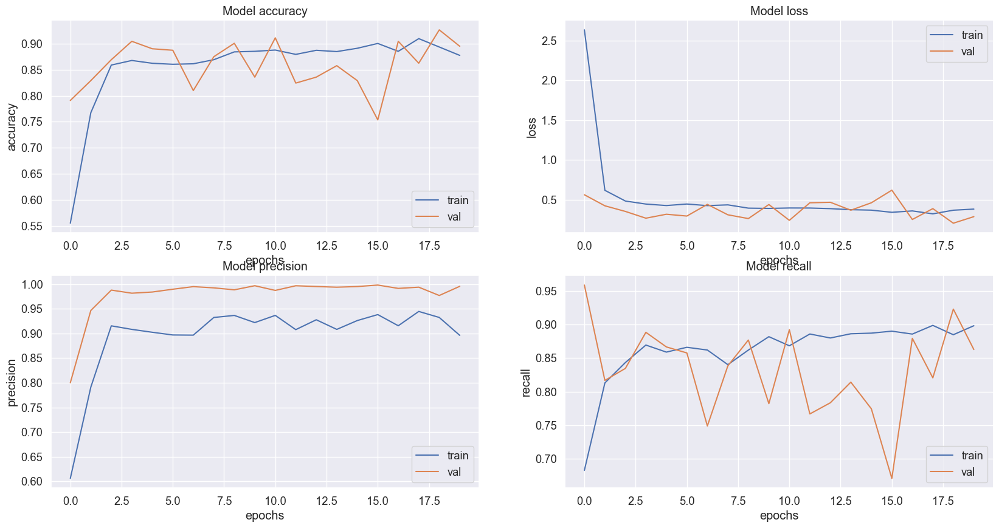

In [163]:
figure, axis = plt.subplots(2, 2, figsize=(20,10))
axis = axis.ravel()

for i,element in enumerate(['accuracy', 'loss','precision','recall']):
    axis[i].plot(modelo_propio1_trained.history[element])
    axis[i].plot(modelo_propio1_trained.history['val_' + element])
    axis[i].set_title('Model {}'.format(element))
    axis[i].set_xlabel('epochs')
    axis[i].set_ylabel(element)
    axis[i].legend(['train', 'val'])

In [164]:
evaluation_modelo_propio1 = modelo_propio1.evaluate(test_generator, steps= 624)
print(f"Test Accuracy: {evaluation_modelo_propio1[1] * 100:.2f}%")
print(f"Test Accuracy: {evaluation_modelo_propio1[2] * 100:.2f}%")
print(f"Test Accuracy: {evaluation_modelo_propio1[3] * 100:.2f}%")

624/624 [==============================] - 11s 17ms/step - loss: 0.3721 - accuracy: 0.8654 - precision: 0.9026 - recall: 0.8795
Test Accuracy: 86.54%
Test Accuracy: 90.26%
Test Accuracy: 87.95%


In [189]:
prediction_modelo1 = modelo_propio1.predict(test_generator)

  5/624 [..............................] - ETA: 8s  

2023-06-19 18:17:17.686059: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


624/624 [==============================] - 6s 9ms/step


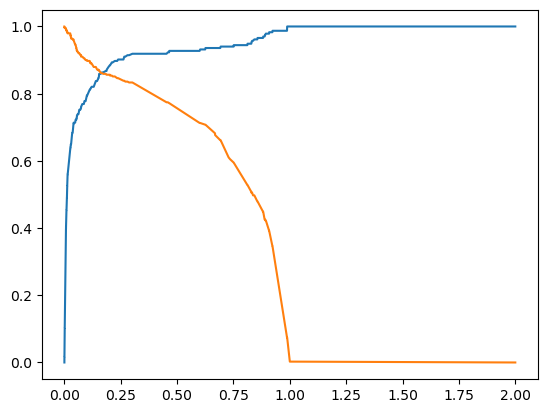

Crossover al 0.16 con especificidad 0.86


In [190]:
y_true = (test_generator.classes ).astype("int")
fpr, tpr, thresholds = roc_curve(y_true, prediction_modelo1)
plt.plot(thresholds, 1.-fpr)
plt.plot(thresholds, tpr)
plt.show()
crossover_index = np.min(np.where(1.-fpr <= tpr))
crossover_cutoff = thresholds[crossover_index]
crossover_specificity = 1.-fpr[crossover_index]
print("Crossover al {0:.2f} con especificidad {1:.2f}".format(crossover_cutoff, crossover_specificity))

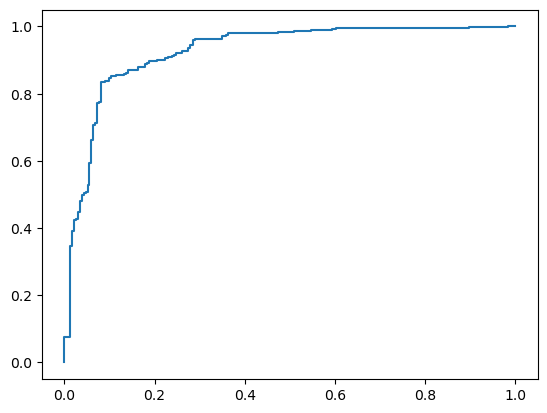

El área bajo la curva ROC es igual a 0.93


In [191]:
plt.plot(fpr, tpr)
plt.show()
print("El área bajo la curva ROC es igual a {0:.2f}".format(roc_auc_score(y_true, prediction_modelo1)))

In [193]:
prediction_modelo1_2 = np.where(prediction_modelo1 < 0.16, np.round(prediction_modelo1) , np.round(prediction_modelo1+0.35) )

confunsion_matriz =  confusion_matrix(test_generator.classes, prediction_modelo1_2)

confunsion_matriz

array([[201,  33],
       [ 53, 337]])

In [96]:
from tensorflow.keras import Model
last_conv_layer = modelo_propio1.get_layer('dense_4')
grad_model = Model([modelo_propio1.inputs], [last_conv_layer.output, modelo_propio1.output])
with tf.GradientTape() as tape:
    conv_outputs, predictions = grad_model(test_generator[0][0])
    loss = predictions[:, np.argmax(predictions[0])]
output = conv_outputs[0]
grads = tape.gradient(loss, conv_outputs)[0]

# Grad-CAM heatmap
weights = np.mean(grads, axis=(0))
cam = np.dot(output, weights)



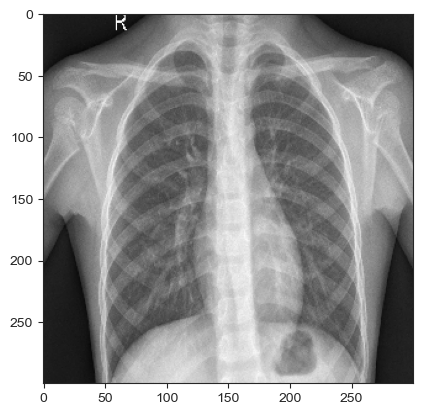

In [97]:
plt.imshow(test_generator[0][0][0])

### Modelo propio 2

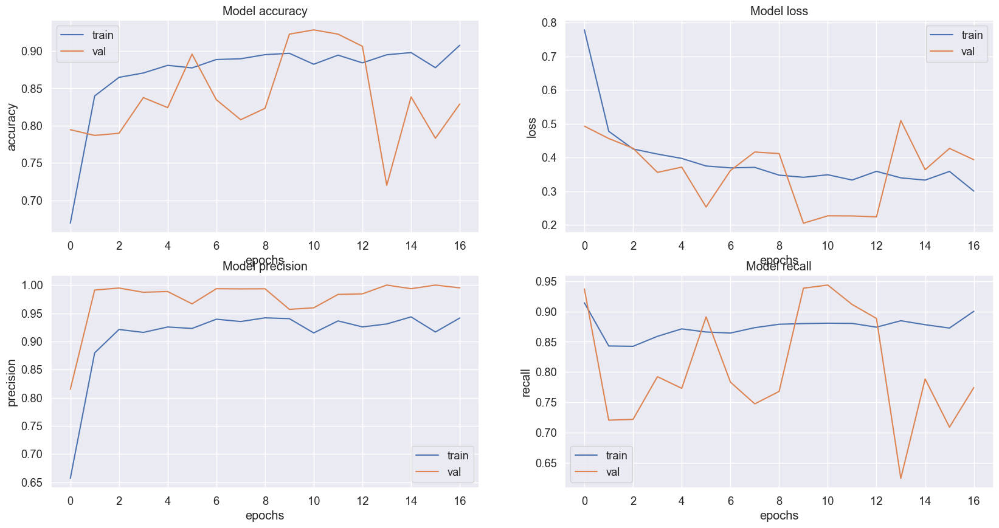

In [174]:
figure, axis = plt.subplots(2, 2, figsize=(20,10))
axis = axis.ravel()

for i,element in enumerate(['accuracy', 'loss','precision','recall']):
    axis[i].plot(modelo_propio2_trained.history[element])
    axis[i].plot(modelo_propio2_trained.history['val_' + element])
    axis[i].set_title('Model {}'.format(element))
    axis[i].set_xlabel('epochs')
    axis[i].set_ylabel(element)
    axis[i].legend(['train', 'val'])

In [175]:
evaluation_modelo_propio2 = modelo_propio2.evaluate(test_generator, steps= 624)
print(f"Test Accuracy: {evaluation_modelo_propio2[1] * 100:.2f}%")


624/624 [==============================] - 17s 25ms/step - loss: 0.4611 - accuracy: 0.8093 - precision: 0.7817 - recall: 0.9641
Test Accuracy: 80.93%


In [137]:
prediction_propio2 = modelo_propio2.predict(test_generator)

2023-06-21 11:37:41.831840: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


624/624 [==============================] - 8s 11ms/step


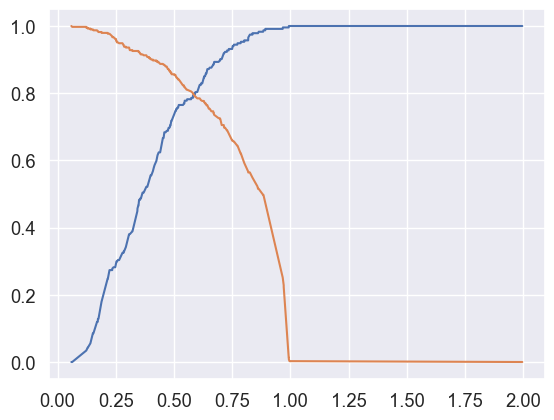

Crossover al 0.58 con especificidad 0.79


In [138]:
y_true = (test_generator.classes ).astype("int")
fpr, tpr, thresholds = roc_curve(y_true, prediction_propio2)
plt.plot(thresholds, 1.-fpr)
plt.plot(thresholds, tpr)
plt.show()
crossover_index = np.min(np.where(1.-fpr <= tpr))
crossover_cutoff = thresholds[crossover_index]
crossover_specificity = 1.-fpr[crossover_index]
print("Crossover al {0:.2f} con especificidad {1:.2f}".format(crossover_cutoff, crossover_specificity))

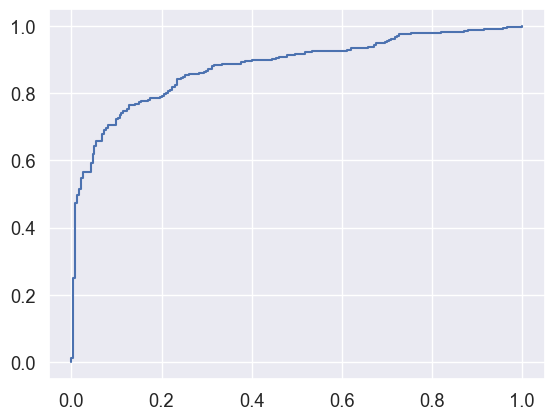

El área bajo la curva ROC es igual a 0.88


In [139]:
plt.plot(fpr, tpr)
plt.show()
print("El área bajo la curva ROC es igual a {0:.2f}".format(roc_auc_score(y_true, prediction_propio2)))

In [143]:
prediction_propio_cross = np.where(prediction_propio2 > 0.49, np.round(prediction_propio2+0.02) , np.round(prediction_propio2) )
prediction_propio_cross_medio = np.where(prediction_propio2 > 0.5, np.round(prediction_propio2) , np.round(prediction_propio2) )

confunsion_matriz =  confusion_matrix(test_generator.classes, prediction_propio_cross_medio)

In [144]:
confunsion_matriz

array([[172,  62],
       [ 56, 334]])

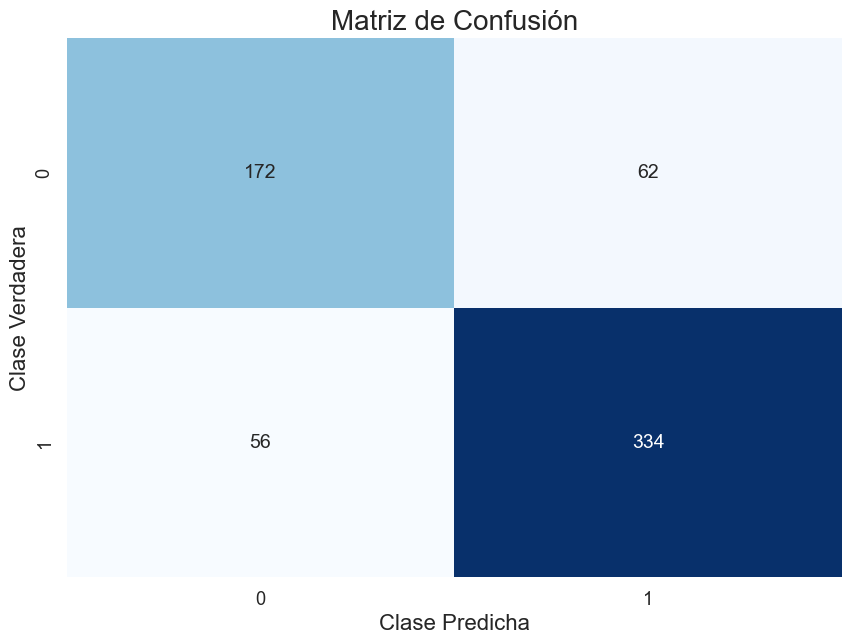

In [145]:
plt.figure(figsize=(10, 7))

# Utilizar Seaborn para crear un heatmap de la matriz de confusión
sns.set(font_scale=1.2)
sns.heatmap(confunsion_matriz, annot=True, fmt='g', cmap='Blues', cbar=False, annot_kws={"size": 14})

# Agregar títulos y etiquetas
plt.title('Matriz de Confusión', fontsize=20)
plt.xlabel('Clase Predicha', fontsize=16)
plt.ylabel('Clase Verdadera', fontsize=16)

# Mostrar la gráfica
plt.show()

In [146]:
from sklearn.metrics import classification_report
print(classification_report(test_generator.classes, prediction_propio_cross_medio))

              precision    recall  f1-score   support

           0       0.75      0.74      0.74       234
           1       0.84      0.86      0.85       390

    accuracy                           0.81       624
   macro avg       0.80      0.80      0.80       624
weighted avg       0.81      0.81      0.81       624



### Modelo propio 3


In [199]:
evaluacion_modelopropio3 = modelo_propio3.evaluate(test_generator)

624/624 [==============================] - 16s 24ms/step - loss: 0.4633 - accuracy: 0.7981 - precision: 0.7762 - recall: 0.9513


In [200]:
prediction_modelopropio3 = modelo_propio3.predict(test_generator)

2023-06-21 19:55:13.449667: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


624/624 [==============================] - 9s 13ms/step


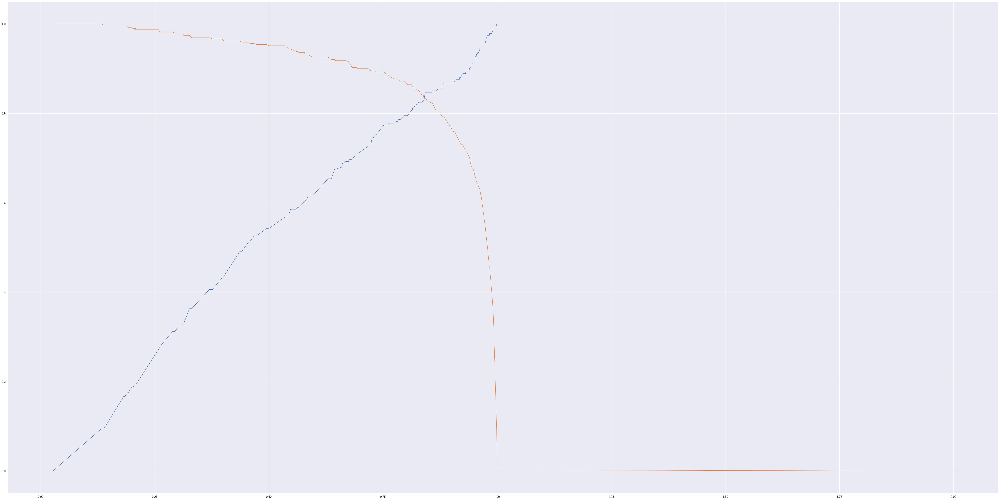

Crossover al 0.84 con especificidad 0.83


In [579]:
y_true = (test_generator.classes ).astype("int")
fpr, tpr, thresholds = roc_curve(y_true, prediction_modelopropio3)
plt.plot(thresholds, 1.-fpr)
plt.plot(thresholds, tpr)
plt.show()
crossover_index = np.min(np.where(1.-fpr <= tpr))
crossover_cutoff = thresholds[crossover_index]
crossover_specificity = 1.-fpr[crossover_index]
print("Crossover al {0:.2f} con especificidad {1:.2f}".format(crossover_cutoff, crossover_specificity))

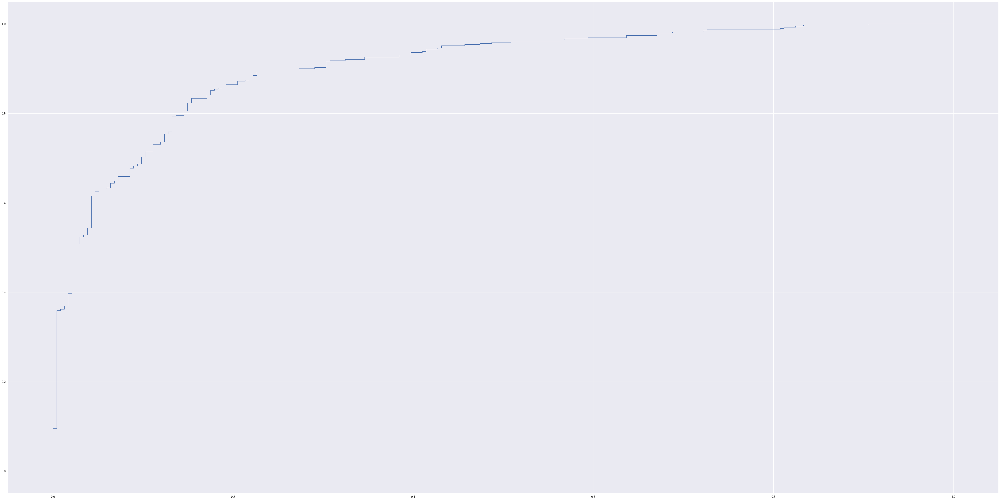

El área bajo la curva ROC es igual a 0.90


In [580]:
plt.plot(fpr, tpr)
plt.show()
print("El área bajo la curva ROC es igual a {0:.2f}".format(roc_auc_score(y_true, prediction_modelopropio3)))

In [581]:
prediction_propio3_cross = np.where(prediction_modelopropio3 > 0.84, np.round(prediction_modelopropio3) , np.round(prediction_modelopropio3 - 0.35) )
prediction_propio3_cross_medio = np.where(prediction_modelopropio3 > 0.5, np.round(prediction_modelopropio3) , np.round(prediction_modelopropio3) )

confunsion_matriz =  confusion_matrix(test_generator.classes, prediction_propio3_cross_medio)

In [582]:
confunsion_matriz

array([[127, 107],
       [ 19, 371]])

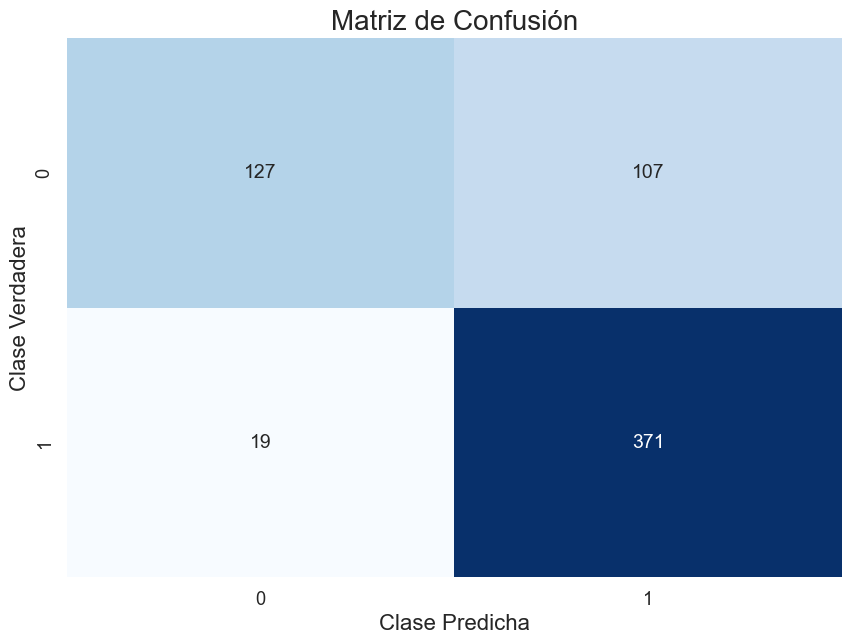

In [210]:
plt.figure(figsize=(10, 7))

# Utilizar Seaborn para crear un heatmap de la matriz de confusión
sns.set(font_scale=1.2)
sns.heatmap(confunsion_matriz, annot=True, fmt='g', cmap='Blues', cbar=False, annot_kws={"size": 14})

# Agregar títulos y etiquetas
plt.title('Matriz de Confusión', fontsize=20)
plt.xlabel('Clase Predicha', fontsize=16)
plt.ylabel('Clase Verdadera', fontsize=16)

# Mostrar la gráfica
plt.show()

In [213]:
from sklearn.metrics import classification_report
print(classification_report(test_generator.classes, prediction_propio3_cross))

              precision    recall  f1-score   support

           0       0.75      0.83      0.79       234
           1       0.89      0.83      0.86       390

    accuracy                           0.83       624
   macro avg       0.82      0.83      0.83       624
weighted avg       0.84      0.83      0.83       624



## Modelos preentrenados

Grafica tensorboard

In [166]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [160]:
os.environ['TENSORBOARD_BINARY'] = '/Users/qiqizhou/Desktop/TFM/logs'


In [167]:
!export TMPDIR=/tmp/USER; 

!mkdir -p $TMPDIR;

In [168]:
!chmod 755

usage:	chmod [-fhv] [-R [-H | -L | -P]] [-a | +a | =a  [i][# [ n]]] mode|entry file ...
	chmod [-fhv] [-R [-H | -L | -P]] [-E | -C | -N | -i | -I] file ...


In [169]:
%tensorboard --logdir logs

ERROR: Failed to start '/Users/qiqizhou/Desktop/TFM/logs' (set by the
`TENSORBOARD_BINARY` environment variable): [Errno 13] Permission
denied: '/Users/qiqizhou/Desktop/TFM/logs'

### VGG16

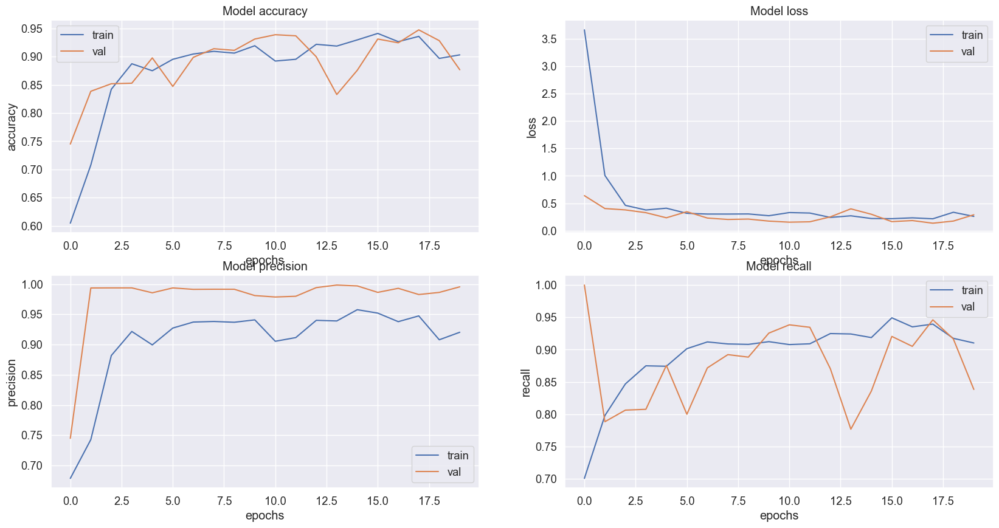

In [75]:
figure, axis = plt.subplots(2, 2, figsize=(20,10))
axis = axis.ravel()

for i,element in enumerate(['accuracy', 'loss','precision','recall']):
    axis[i].plot(vgg16_modelo_trained2.history[element])
    axis[i].plot(vgg16_modelo_trained2.history['val_' + element])
    axis[i].set_title('Model {}'.format(element))
    axis[i].set_xlabel('epochs')
    axis[i].set_ylabel(element)
    axis[i].legend(['train', 'val'])

In [76]:
vgg16_modelo.evaluate(test_generator, steps=624)

624/624 [==============================] - 25s 37ms/step - loss: 0.2355 - accuracy: 0.9038 - precision: 0.9412 - recall: 0.9026


[0.23549507558345795,
 0.9038461446762085,
 0.9411764740943909,
 0.9025641083717346]

Gráfica


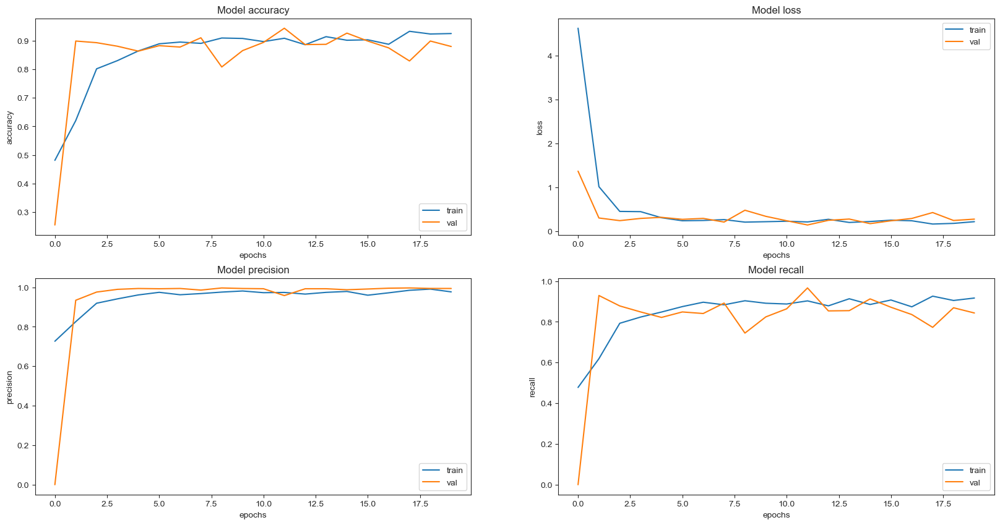

In [53]:
figure, axis = plt.subplots(2, 2, figsize=(20,10))
axis = axis.ravel()

for i,element in enumerate(['accuracy', 'loss','precision','recall']):
    axis[i].plot(vgg16_modelo_trained.history[element])
    axis[i].plot(vgg16_modelo_trained.history['val_' + element])
    axis[i].set_title('Model {}'.format(element))
    axis[i].set_xlabel('epochs')
    axis[i].set_ylabel(element)
    axis[i].legend(['train', 'val'])

Prediccion test

Sirve para separar los clases de test

In [73]:
no_idx = list(range(1, 235))
yes_idx = list(range(235, 624))

Predicción de la modelo VGG

In [78]:
prediction_vgg = vgg16_modelo.predict(test_generator)

2023-06-20 18:37:59.083358: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


624/624 [==============================] - 15s 21ms/step


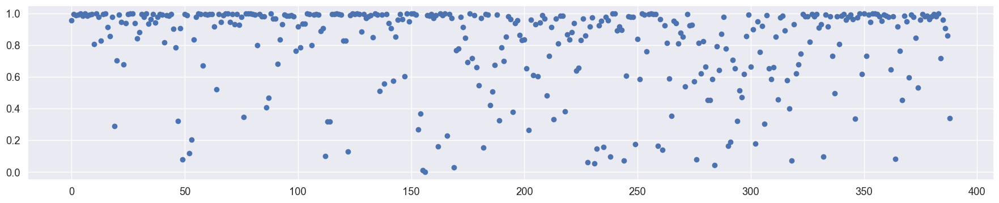

In [832]:
plt.plot([prediction_vgg[i] for i in yes_idx], 'bo')
plt.show()

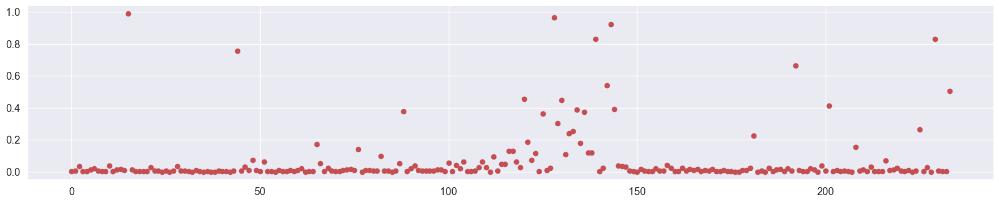

In [833]:
plt.plot([prediction_vgg[i] for i in no_idx], 'ro')
plt.show()

Punto óptimo de corte 

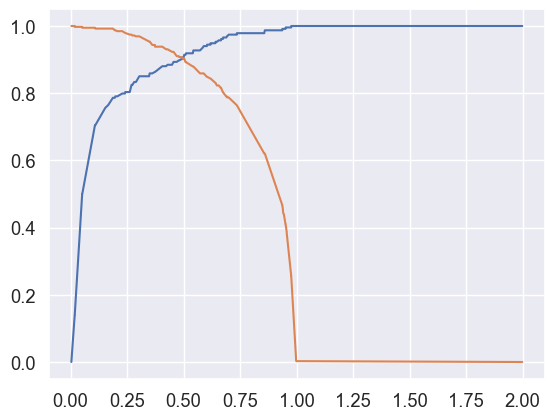

Crossover al 0.49 con especificidad 0.90


In [79]:
y_true = (test_generator.classes ).astype("int")
fpr, tpr, thresholds = roc_curve(y_true, prediction_vgg)
plt.plot(thresholds, 1.-fpr)
plt.plot(thresholds, tpr)
plt.show()
crossover_index = np.min(np.where(1.-fpr <= tpr))
crossover_cutoff = thresholds[crossover_index]
crossover_specificity = 1.-fpr[crossover_index]
print("Crossover al {0:.2f} con especificidad {1:.2f}".format(crossover_cutoff, crossover_specificity))

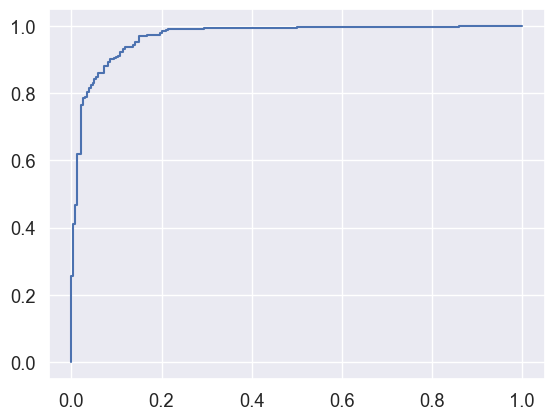

El área bajo la curva ROC es igual a 0.97


In [80]:
plt.plot(fpr, tpr)
plt.show()
print("El área bajo la curva ROC es igual a {0:.2f}".format(roc_auc_score(y_true, prediction_vgg)))

In [92]:
prediction2 = np.where(prediction_vgg > 0.49, np.round(prediction_vgg+0.02) , np.round(prediction_vgg) )

confunsion_matriz =  confusion_matrix(test_generator.classes, prediction2)

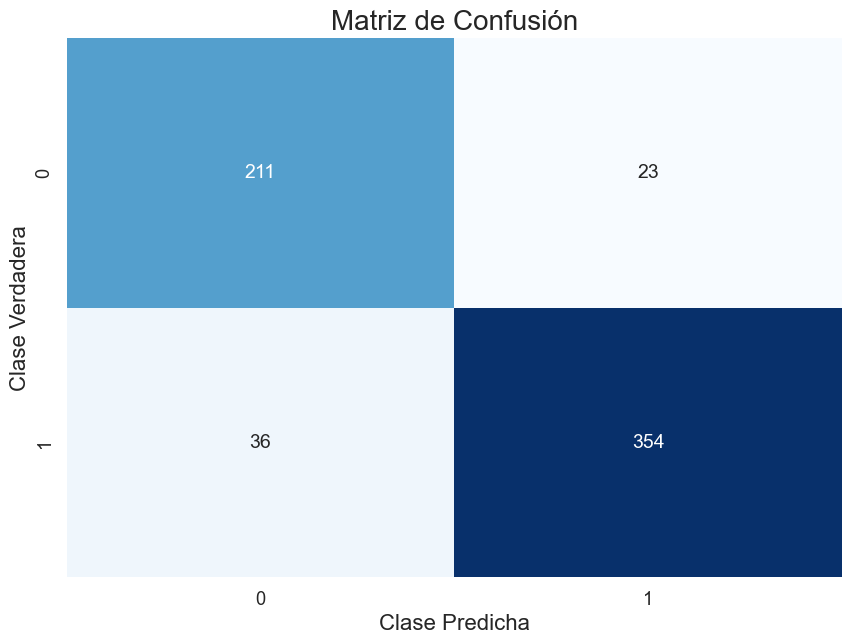

In [93]:
plt.figure(figsize=(10, 7))

# Utilizar Seaborn para crear un heatmap de la matriz de confusión
sns.set(font_scale=1.2)
sns.heatmap(confunsion_matriz, annot=True, fmt='g', cmap='Blues', cbar=False, annot_kws={"size": 14})

# Agregar títulos y etiquetas
plt.title('Matriz de Confusión', fontsize=20)
plt.xlabel('Clase Predicha', fontsize=16)
plt.ylabel('Clase Verdadera', fontsize=16)

# Mostrar la gráfica
plt.show()

In [94]:
from sklearn.metrics import classification_report
print(classification_report(test_generator.classes, prediction2))

              precision    recall  f1-score   support

           0       0.85      0.90      0.88       234
           1       0.94      0.91      0.92       390

    accuracy                           0.91       624
   macro avg       0.90      0.90      0.90       624
weighted avg       0.91      0.91      0.91       624



In [86]:
report = classification_report(test_generator.classes, prediction2, output_dict=True)

# Convierte el informe en un DataFrame de Pandas
df = pd.DataFrame(report).transpose()

# Muestra el DataFrame
print(df)

              precision    recall  f1-score     support
0              0.854251  0.901709  0.877339  234.000000
1              0.938992  0.907692  0.923077  390.000000
accuracy       0.905449  0.905449  0.905449    0.905449
macro avg      0.896622  0.904701  0.900208  624.000000
weighted avg   0.907214  0.905449  0.905925  624.000000


Para ver cuáles se ha equivocado y hacer un chequeo

In [255]:
#vgg_model_importado = tf.keras.models.load_model('modelos/model_vgg.h5')

wrong_predicted_image = [[],[]]
correct_predicted_image = [[],[]]
i = 0 # el tamaño de imaganes que tenemos y el len de al lado (en nuestro caso tenemos solamente 624 imagenes en test)
# es hasta las malas predichas que queremos
while i< 624 and len(wrong_predicted_image[0]) < 200:
    j = 0
    while j < 1 and len(wrong_predicted_image[0]) <200:
        #print(i,0,j)
        image_array = (test_generator[i][0][j]).reshape(1,300,300,3)
        
        prediction = vgg16_modelo.predict(image_array)
        
        if int(round(prediction[0][0])) != test_generator[i][1][j]:
            wrong_predicted_image[0].append(image_array)
            wrong_predicted_image[1].append(int(round(prediction[0][0])))
            
        elif len(correct_predicted_image[0]) < 600:
            correct_predicted_image[0].append(image_array)
            correct_predicted_image[1].append(int(round(prediction[0][0])))
#         print(len(correct_predicted_image[0]),len(wrong_predicted_image[0]))  
        j += 1
        
    i += 1

2023-06-12 16:55:33.346026: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 32ms/step


In [293]:
print(len(correct_predicted_image[1]))
len(wrong_predicted_image[1])

564


60

Mostrar todas las imagenes mal predichas con su etiqueta predicha

In [ ]:
for i, buenos in enumerate(wrong_predicted_image[0]):
    image = tf.keras.preprocessing.image.array_to_img(buenos.reshape(300,300,3))
    plt.imshow(image)
    plt.axis('off')  # Para ocultar los ejes
    
    # Agregar título con la etiqueta correspondiente
    etiqueta = wrong_predicted_image[1][i]
    plt.title(f'Etiqueta predicha: {etiqueta}', fontsize=10)
    
    plt.show()

wrong_prediction_by_model --- [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


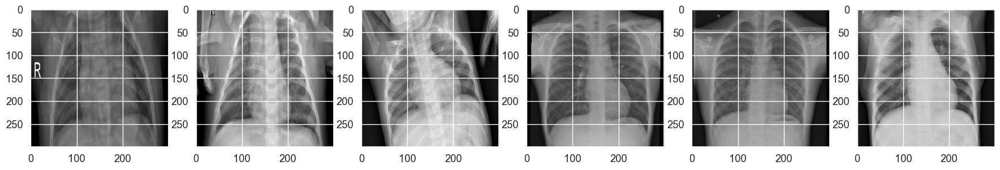

In [295]:
rcParams['figure.figsize'] = 22 ,4
fig, ax = plt.subplots(1,6)

i = 0

for ele in wrong_predicted_image[0]:
    image = tf.keras.preprocessing.image.array_to_img(ele.reshape(300,300,3))
    ax[i].imshow(image) 
    i += 1
    if i == 6:
        break;

print(f'wrong_prediction_by_model --- {wrong_predicted_image[1]}')

Para mostrar todas las que se quiera

wrong_prediction_by_model --- [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


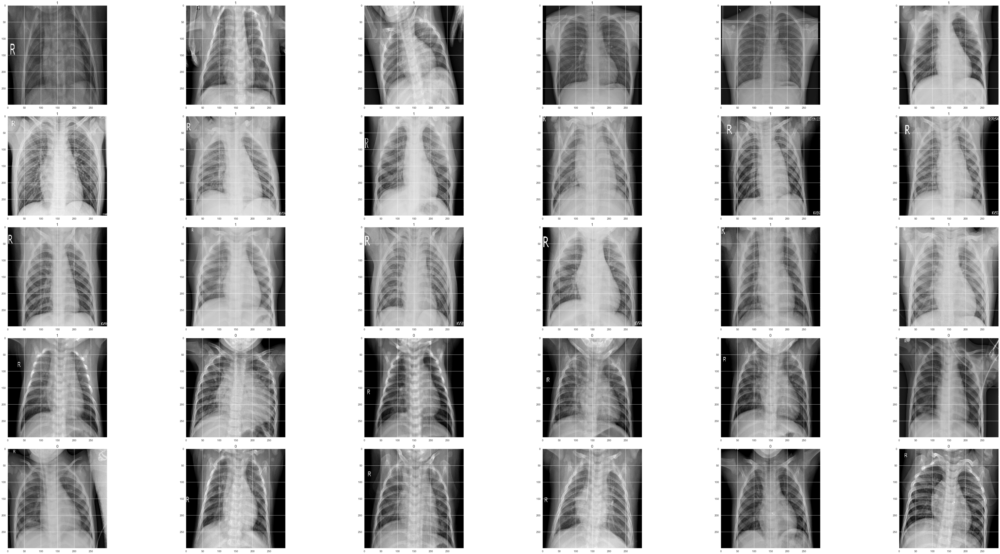

In [292]:
rcParams['figure.figsize'] = 80 ,40

print(f'wrong_prediction_by_model --- {wrong_predicted_image[1]}')
fig, ax = plt.subplots(5, 6) # filas y columnas

for row in range(5):
    for col in range(6):
        index = row * 6 + col  # Índice de la imagen en wrong_predicted_image
        if index < len(wrong_predicted_image[0]):
            ele = wrong_predicted_image[0][index]
            image = tf.keras.preprocessing.image.array_to_img(ele.reshape(300, 300, 3))
            ax[row][col].imshow(image)
            ax[row][col].set_title(f'{wrong_predicted_image[1][index]}', fontsize=20)
        else:
            # Si no hay suficientes imágenes, se muestra un espacio en blanco
            ax[row][col].axis('off')
plt.tight_layout()
plt.show()

correct_prediction_by_model --- [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

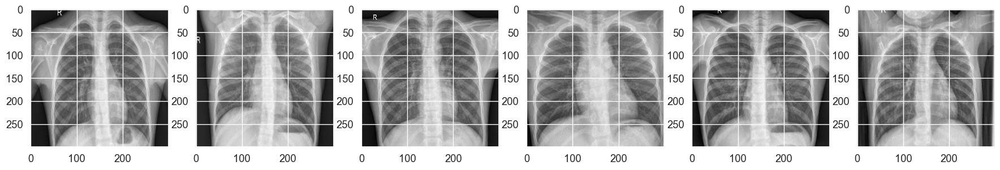

In [256]:
rcParams['figure.figsize'] = 22 ,4
fig, ax = plt.subplots(1,6)

i = 0
for ele in correct_predicted_image[0]:
    image = tf.keras.preprocessing.image.array_to_img(ele.reshape(300,300,3))
    ax[i].imshow(image)
    i += 1
    if i == 6:
        break;

print(f'correct_prediction_by_model --- {correct_predicted_image[1]}')

In [691]:
vgg16_modelo.evaluate(test_generator, steps= 624)

624/624 [==============================] - 22s 35ms/step - loss: 0.6382 - accuracy: 0.6747 - precision: 0.9895 - recall: 0.4846


[0.6381601095199585,
 0.6746794581413269,
 0.9895287752151489,
 0.48461538553237915]

In [616]:
evaluation_vgg = vgg16_modelo.evaluate(test_generator, steps= 624)

624/624 [==============================] - 21s 33ms/step - loss: 0.2679 - accuracy: 0.9006 - precision: 0.8850 - recall: 0.9667


In [617]:
print('loss rate at evaluation data :', evaluation_vgg[0])
print('accuracy rate at evaluation data :', evaluation_vgg[1])
print('precision rate at evaluation data :', evaluation_vgg[2])
print('recall rate at evaluation data :', evaluation_vgg[3])

loss rate at evaluation data : 0.2679091989994049
accuracy rate at evaluation data : 0.9006410241127014
precision rate at evaluation data : 0.8849765062332153
recall rate at evaluation data : 0.9666666388511658


In [64]:
vgg16_modelo.save('modelos_entero/vgg_0,32_0,8589,0,84953_0,9461')

INFO:tensorflow:Assets written to: modelos_entero/vgg_0,32_0,8589,0,84953_0,9461/assets


INFO:tensorflow:Assets written to: modelos_entero/vgg_0,32_0,8589,0,84953_0,9461/assets


### Inception

Gráfica 

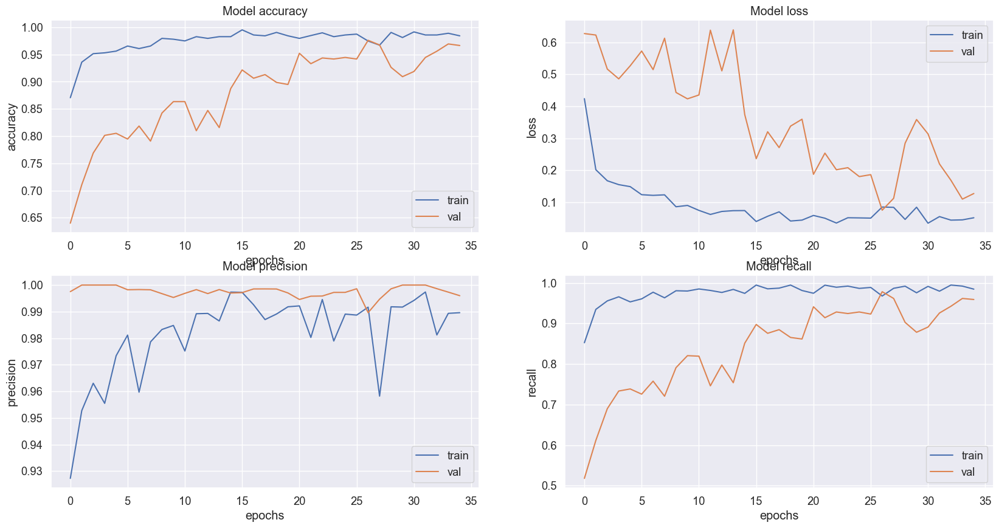

In [284]:
figure, axis = plt.subplots(2, 2, figsize=(20,10))
axis = axis.ravel()

for i,element in enumerate(['accuracy', 'loss','precision','recall']):
    axis[i].plot(inceptionv3_modelo_imagenet_trained2.history[element])
    axis[i].plot(inceptionv3_modelo_imagenet_trained2.history['val_' + element])
    axis[i].set_title('Model {}'.format(element))
    axis[i].set_xlabel('epochs')
    axis[i].set_ylabel(element)
    axis[i].legend(['train', 'val'])

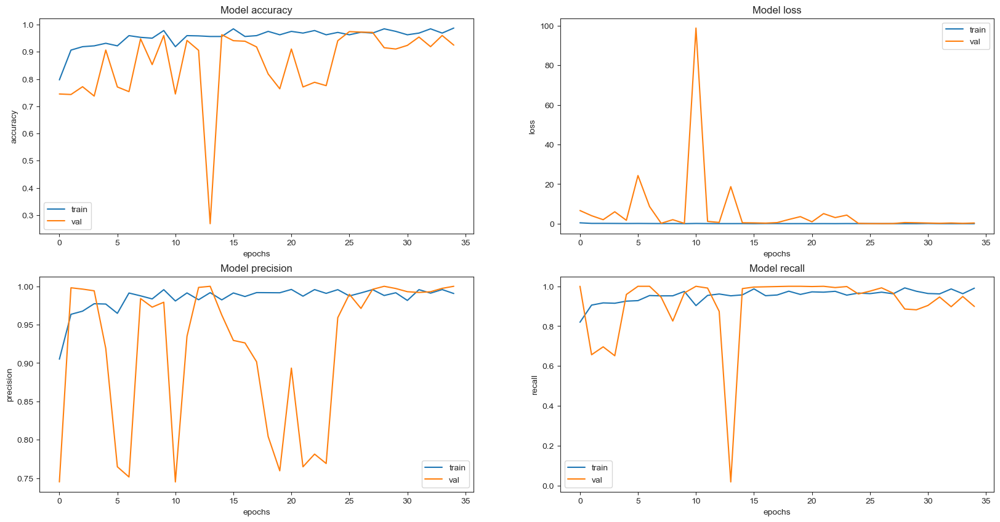

In [62]:
figure, axis = plt.subplots(2, 2, figsize=(20,10))
axis = axis.ravel()

for i,element in enumerate(['accuracy', 'loss','precision','recall']):
    axis[i].plot(inceptionv3_modelo_imagenet_trained.history[element])
    axis[i].plot(inceptionv3_modelo_imagenet_trained.history['val_' + element])
    axis[i].set_title('Model {}'.format(element))
    axis[i].set_xlabel('epochs')
    axis[i].set_ylabel(element)
    axis[i].legend(['train', 'val'])

# Estudio de interpretabilidad

In [101]:
inception_model_importado = tf.keras.models.load_model('modelos_entero/inception_0,29_0,926,0,365_0,9461')

In [339]:
import shap
shap.initjs()

/opt/anaconda3/envs/Creadonuevo/lib/python3.10/site-packages/shap/utils/_clustering.py:35: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def _pt_shuffle_rec(i, indexes, index_mask, partition_tree, M, pos):
/opt/anaconda3/envs/Creadonuevo/lib/python3.10/site-packages/shap/utils/_clustering.py:54: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def delta_minimizatio

In [340]:
imagen = cv2.imread("/Users/qiqizhou/Desktop/TFM/chest_xray/test/NORMAL/NORMAL2-IM-0041-0001.jpeg")
imagen_test = cv2.imread("/Users/qiqizhou/Desktop/TFM/chest_xray/test/NORMAL/NORMAL2-IM-0060-0001.jpeg")

In [410]:
batch = test_generator.next()
images_for_explanation = batch[0] 

In [448]:
batch2 = test_generator2.next()
images_for_explanation_2 = batch2[0] 


In [438]:
for i in range(300):
    batch2 = test_generator2.next()

In [440]:
batch2[1]

array([1.], dtype=float32)

In [422]:
for i in range(100):
    batch = test_generator.next()

images_for_explanation = batch[0] 

In [423]:
imagen_t = batch[0]
eti_t = batch[1]

In [424]:
eti_t

array([1.], dtype=float32)

In [425]:
batch_train = train_generator_oversampling.next()
images_for_explanation_train = batch_train[0]

In [345]:
num_reference_images = 100  # El número de imágenes de referencia que deseas utilizar
reference_images = []
for i in range((num_reference_images + train_generator_oversampling.batch_size - 1) // train_generator_oversampling.batch_size):
    images, _ = next(train_generator_oversampling)
    reference_images.extend(images)
    if len(reference_images) >= num_reference_images:
        break
reference_images = np.array(reference_images)[:num_reference_images]

In [369]:
num_reference_images2 = 100  # El número de imágenes de referencia que deseas utilizar
reference_images2 = []
for i in range((num_reference_images2 + train_generator_oversampling2.batch_size - 1) // train_generator_oversampling2.batch_size):
    images, _ = next(train_generator_oversampling2)
    reference_images2.extend(images)
    if len(reference_images2) >= num_reference_images2:
        break
reference_images2 = np.array(reference_images2)[:num_reference_images2]

mobilnet

In [373]:
explainer = shap.GradientExplainer(model_mobil, reference_images2)

# we explain the model's predictions on the first three samples of the test set
shap_values = explainer.shap_values(reference_images2)


2023-06-22 21:13:59.824226: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


inception

In [347]:
explainer = shap.GradientExplainer(inception_model_importado, reference_images)

# we explain the model's predictions on the first three samples of the test set
shap_values = explainer.shap_values(reference_images[:100])



`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.
2023-06-22 20:53:56.335450: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


In [451]:
batch2 = test_generator2.next()
images_for_explanation_2 = batch2[0] 

In [452]:
shap_values = explainer.shap_values(images_for_explanation_2)

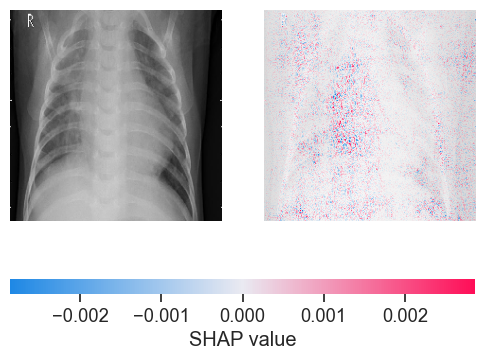

In [453]:
shap.image_plot(shap_values, images_for_explanation_2)

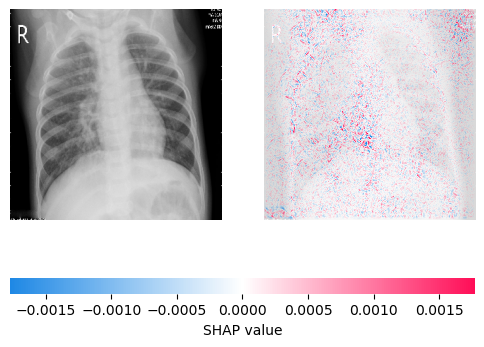

In [145]:
shap.image_plot(shap_values, images_for_explanation)

Prediccion test

In [285]:
inceptionv3_modelo_imagenet.evaluate(test_generator)

624/624 [==============================] - 80s 110ms/step - loss: 0.2312 - accuracy: 0.9199 - precision: 0.9048 - recall: 0.9744


[0.23116599023342133,
 0.9198718070983887,
 0.9047619104385376,
 0.9743589758872986]

In [290]:
prediction_inception_buena = inceptionv3_modelo_imagenet.predict(test_generator)

2023-06-22 19:30:38.567321: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


624/624 [==============================] - 59s 73ms/step


In [286]:
prediction_inception = inception_model_importado.predict(test_generator)

624/624 [==============================] - 43s 65ms/step


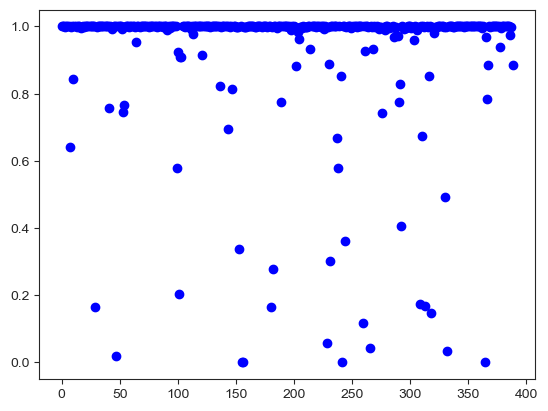

In [27]:
plt.plot([prediction_inception[i] for i in yes_idx], 'bo')
plt.show()

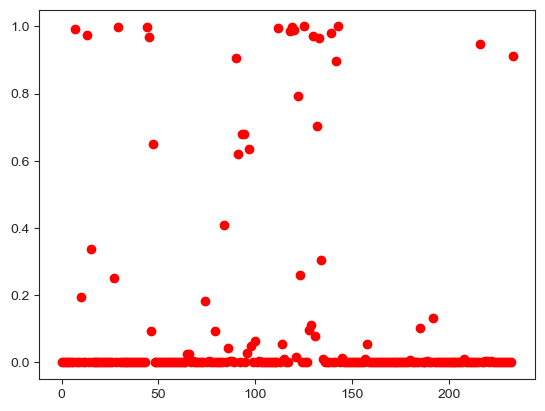

In [28]:
plt.plot([prediction_inception[i] for i in no_idx], 'ro')
plt.show()

Punto óptimo de corte

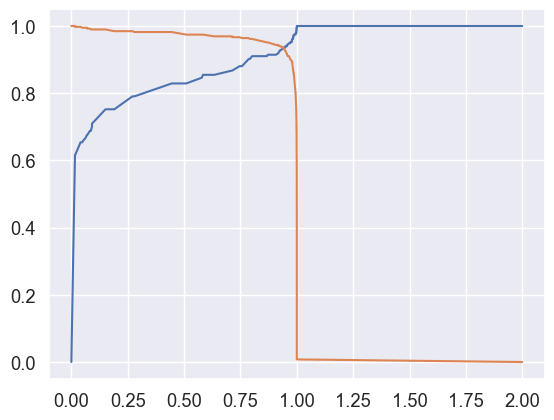

Crossover al 0.94 con especificidad 0.93 y sensibilidad 0.933333


In [291]:
y_true = (test_generator.classes ).astype("int")
fpr, tpr, thresholds = roc_curve(y_true, prediction_inception_buena)
plt.plot(thresholds, 1.-fpr)
plt.plot(thresholds, tpr)
plt.show()
crossover_index = np.min(np.where(1.-fpr <= tpr))
crossover_cutoff = thresholds[crossover_index]
crossover_specificity = 1.-fpr[crossover_index]
crossover_sensitivity = tpr[crossover_index]
print("Crossover al {0:.2f} con especificidad {1:.2f} y sensibilidad {2:2f}".format(crossover_cutoff, crossover_specificity, crossover_sensitivity))

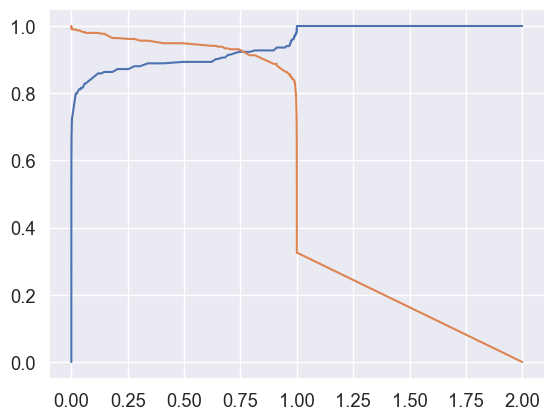

Crossover al 0.74 con especificidad 0.92 y sensibilidad 0.930769


In [103]:
y_true = (test_generator.classes ).astype("int")
fpr, tpr, thresholds = roc_curve(y_true, prediction_inception)
plt.plot(thresholds, 1.-fpr)
plt.plot(thresholds, tpr)
plt.show()
crossover_index = np.min(np.where(1.-fpr <= tpr))
crossover_cutoff = thresholds[crossover_index]
crossover_specificity = 1.-fpr[crossover_index]
crossover_sensitivity = tpr[crossover_index]
print("Crossover al {0:.2f} con especificidad {1:.2f} y sensibilidad {2:2f}".format(crossover_cutoff, crossover_specificity, crossover_sensitivity))

In [ ]:
plt.plot(fpr, tpr)
plt.show()
print("El área bajo la curva ROC es igual a {0:.2f}".format(roc_auc_score(y_true, prediction_inception)))

Ajuste de threshold y matriz de confunsion

In [294]:
prediction_inception_crossover = np.where(prediction_inception > 0.74, np.round(prediction_inception) , np.round(prediction_inception-0.5) )

prediction_inception_crossover_medio = np.where(prediction_inception > 0.5, np.round(prediction_inception) , np.round(prediction_inception) )

prediction_inception_crossover_medio_buena = np.where(prediction_inception_buena > 0.5, np.round(prediction_inception_buena) , np.round(prediction_inception_buena) )

confunsion_matriz =  confusion_matrix(test_generator.classes, prediction_inception_crossover_medio)

In [295]:
confunsion_matriz

array([[209,  25],
       [ 21, 369]])

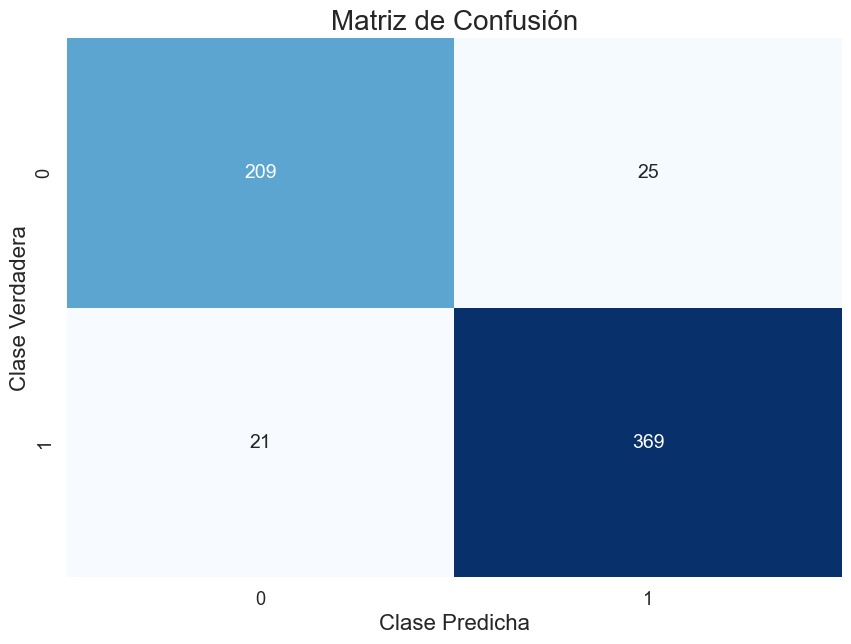

In [107]:
plt.figure(figsize=(10, 7))

# Utilizar Seaborn para crear un heatmap de la matriz de confusión
sns.set(font_scale=1.2)
sns.heatmap(confunsion_matriz, annot=True, fmt='g', cmap='Blues', cbar=False, annot_kws={"size": 14})

# Agregar títulos y etiquetas
plt.title('Matriz de Confusión', fontsize=20)
plt.xlabel('Clase Predicha', fontsize=16)
plt.ylabel('Clase Verdadera', fontsize=16)

# Mostrar la gráfica
plt.show()

In [108]:
print(classification_report(test_generator.classes, prediction_inception_crossover_medio))

              precision    recall  f1-score   support

           0       0.91      0.89      0.90       234
           1       0.94      0.95      0.94       390

    accuracy                           0.93       624
   macro avg       0.92      0.92      0.92       624
weighted avg       0.93      0.93      0.93       624



In [408]:
accuracy = np.trace(confunsion_matriz) / np.sum(confunsion_matriz)

# Calculate recall (sensitivity)
recall = confunsion_matriz[1, 1] / (confunsion_matriz[1, 0] + confunsion_matriz[1, 1])

# Calculate precision
precision = confunsion_matriz[1, 1] / (confunsion_matriz[0, 1] + confunsion_matriz[1, 1])

# Calculate F1-Score
f1_score = 2 * (precision * recall) / (precision + recall)

print("Accuracy: ", accuracy)
print("Recall: ", recall)
print("Precision: ", precision)
print("F1-Score: ", f1_score)

Accuracy:  0.9262820512820513
Recall:  0.9307692307692308
Precision:  0.9502617801047121
F1-Score:  0.9404145077720208


In [390]:
#inception_model_importado = tf.keras.models.load_model('modelos_entero/inception_0,29_0,926,0,365_0,9461')

wrong_predicted_image = [[],[]]
correct_predicted_image = [[],[]]
i = 0 # el tamaño de imaganes que tenemos y el len de al lado (en nuestro caso tenemos solamente 624 imagenes en test)
# es hasta las malas que queremos
while i< 624 and len(wrong_predicted_image[0]) < 200:
    j = 0
    while j < 1 and len(wrong_predicted_image[0]) < 200:
        #print(i,0,j)
        image_array = (test_generator[i][0][j]).reshape(1,300,300,3)
        
        prediction = inception_model_importado.predict(image_array)
        
        if int(round(prediction[0][0])) != test_generator[i][1][j]:
            wrong_predicted_image[0].append(image_array)
            wrong_predicted_image[1].append(int(round(prediction[0][0])))
            
        elif len(correct_predicted_image[0]) < 600: # en caso de que queramos que guarda hasta un numero de correctas 
            correct_predicted_image[0].append(image_array)
            correct_predicted_image[1].append(int(round(prediction[0][0])))
#         print(len(correct_predicted_image[0]),len(wrong_predicted_image[0]))  
        j += 1
        
    i += 1

2023-06-12 18:56:24.182862: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 76ms/step


In [392]:
print(len(correct_predicted_image[1]))
len(wrong_predicted_image[1])

578


46

wrong_prediction_by_model --- [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


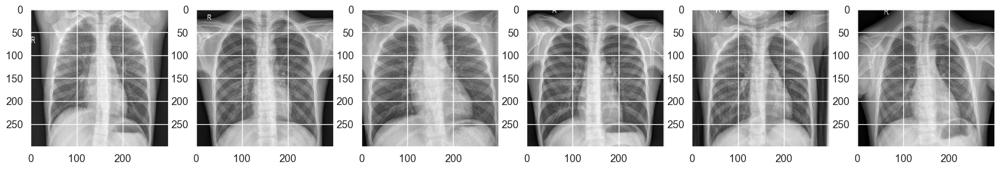

In [394]:
rcParams['figure.figsize'] = 22 ,4
fig, ax = plt.subplots(1,6)

i = 0
for ele in correct_predicted_image[0]:
    image = tf.keras.preprocessing.image.array_to_img(ele.reshape(300,300,3))
    ax[i].imshow(image)
    i += 1
    if i ==6 :
        break

print(f'wrong_prediction_by_model --- {wrong_predicted_image[1]}')

In [46]:
evaluation_inception = inceptionv3_modelo_imagenet.evaluate(test_generator, steps=624)

2023-07-11 22:18:57.210916: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


624/624 [==============================] - 48s 70ms/step - loss: 0.2978 - accuracy: 0.9263 - precision: 0.9365 - recall: 0.9462


In [47]:
print('loss rate at evaluation data :', evaluation_inception[0])
print('accuracy rate at evaluation data :', evaluation_inception[1])
print('precision rate at evaluation data :', evaluation_inception[2])
print('recall rate at evaluation data :', evaluation_inception[3])

loss rate at evaluation data : 0.2978222072124481
accuracy rate at evaluation data : 0.9262820482254028
precision rate at evaluation data : 0.9365482330322266
recall rate at evaluation data : 0.9461538195610046


 Si es bueno el modelo entonces lo guardamos por completo para no volver a ejecutar todo de nuevo

In [69]:
inceptionv3_modelo_imagenet.save('modelos_entero/inception_0,29_0,926,0,365_0,9461')

INFO:tensorflow:Assets written to: modelos_entero/inception_0,29_0,926,0,365_0,9461/assets


INFO:tensorflow:Assets written to: modelos_entero/inception_0,29_0,926,0,365_0,9461/assets


### ResNet50

Gráfica

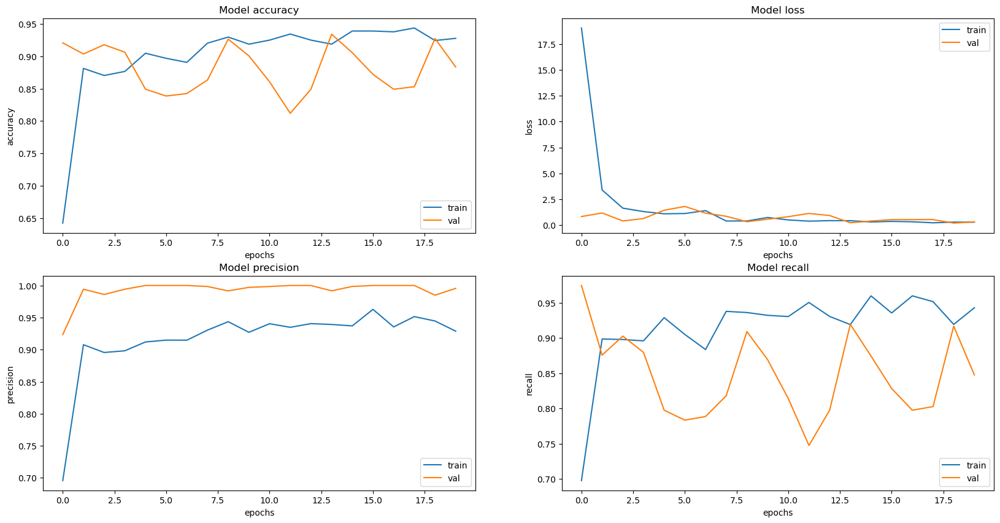

In [57]:
figure, axis = plt.subplots(2, 2, figsize=(20,10))
axis = axis.ravel()

for i,element in enumerate(['accuracy', 'loss','precision','recall']):
    axis[i].plot(resnet50_modelo_trained2.history[element])
    axis[i].plot(resnet50_modelo_trained2.history['val_' + element])
    axis[i].set_title('Model {}'.format(element))
    axis[i].set_xlabel('epochs')
    axis[i].set_ylabel(element)
    axis[i].legend(['train', 'val'])

In [58]:
resnet50_modelo.evaluate(test_generator)

624/624 [==============================] - 43s 62ms/step - loss: 0.2539 - accuracy: 0.9151 - precision: 0.9399 - recall: 0.9231


[0.25394192337989807,
 0.9150640964508057,
 0.939947783946991,
 0.9230769276618958]

In [215]:
resnet50_modelo.save('modelo_vista/resnet50v2_utlimo.h5')

In [59]:
prediction_resnet = resnet50_modelo.predict(test_generator)

2023-06-20 17:42:09.126990: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


624/624 [==============================] - 35s 47ms/step


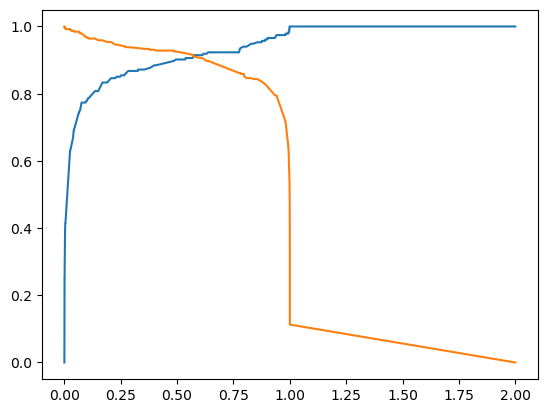

Crossover al 0.57 con especificidad 0.91


In [60]:
y_true = (test_generator.classes ).astype("int")
fpr, tpr, thresholds = roc_curve(y_true, prediction_resnet)
plt.plot(thresholds, 1.-fpr)
plt.plot(thresholds, tpr)
plt.show()
crossover_index = np.min(np.where(1.-fpr <= tpr))
crossover_cutoff = thresholds[crossover_index]
crossover_specificity = 1.-fpr[crossover_index]
print("Crossover al {0:.2f} con especificidad {1:.2f}".format(crossover_cutoff, crossover_specificity))

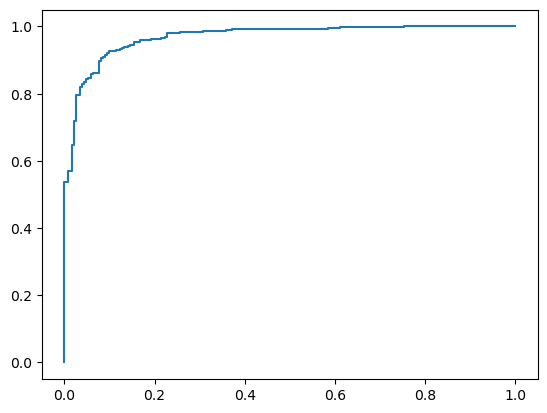

El área bajo la curva ROC es igual a 0.97


In [61]:
plt.plot(fpr, tpr)
plt.show()
print("El área bajo la curva ROC es igual a {0:.2f}".format(roc_auc_score(y_true, prediction_resnet)))

In [97]:
prediction_resnet_crossover = np.where(prediction_resnet > 0.57, np.round(prediction_resnet) , np.round(prediction_resnet-0.5) )
prediction_resnet_crossover_medio = np.where(prediction_resnet > 0.49, np.round(prediction_resnet) , np.round(prediction_resnet) )

confunsion_matriz =  confusion_matrix(test_generator.classes, prediction_resnet_crossover_medio)

In [98]:
confunsion_matriz

array([[211,  23],
       [ 30, 360]])

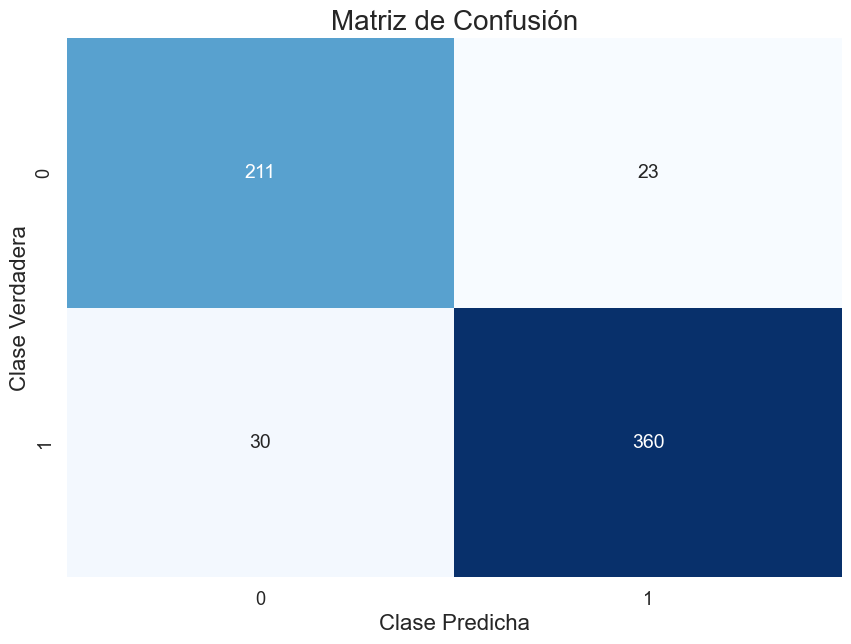

In [99]:
plt.figure(figsize=(10, 7))

# Utilizar Seaborn para crear un heatmap de la matriz de confusión
sns.set(font_scale=1.2)
sns.heatmap(confunsion_matriz, annot=True, fmt='g', cmap='Blues', cbar=False, annot_kws={"size": 14})

# Agregar títulos y etiquetas
plt.title('Matriz de Confusión', fontsize=20)
plt.xlabel('Clase Predicha', fontsize=16)
plt.ylabel('Clase Verdadera', fontsize=16)

# Mostrar la gráfica
plt.show()

In [100]:
from sklearn.metrics import classification_report
print(classification_report(test_generator.classes, prediction_resnet_crossover_medio))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89       234
           1       0.94      0.92      0.93       390

    accuracy                           0.92       624
   macro avg       0.91      0.91      0.91       624
weighted avg       0.92      0.92      0.92       624



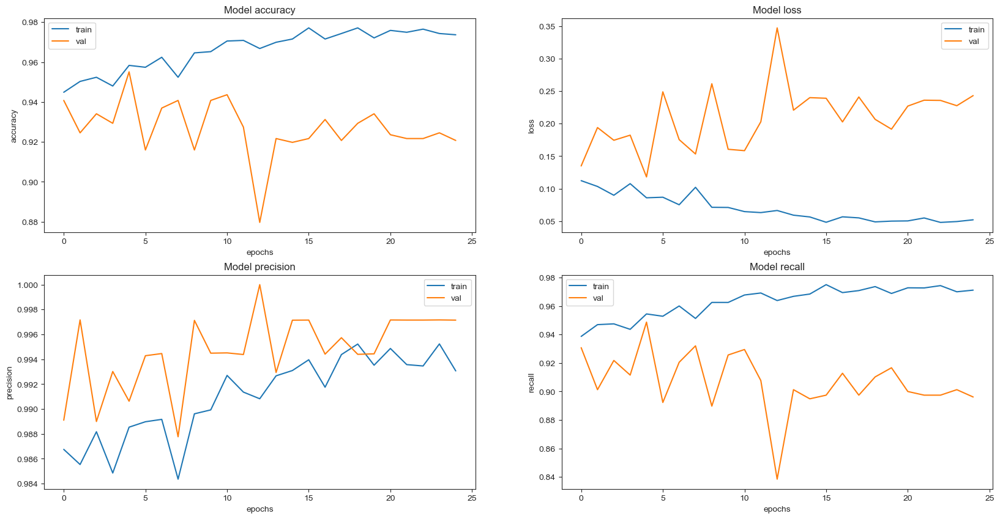

In [78]:
figure, axis = plt.subplots(2, 2, figsize=(20,10))
axis = axis.ravel()

for i,element in enumerate(['accuracy', 'loss','precision','recall']):
    axis[i].plot(resnet50_modelo_trained.history[element])
    axis[i].plot(resnet50_modelo_trained.history['val_' + element])
    axis[i].set_title('Model {}'.format(element))
    axis[i].set_xlabel('epochs')
    axis[i].set_ylabel(element)
    axis[i].legend(['train', 'val'])

### Prediction

In [ ]:
resnet_modelo_importado = tf.keras.models.load_model('modelos/model_resnet.h5')

wrong_predicted_image = [[],[]]
correct_predicted_image = [[],[]]
i = 0 # el tamaño de imaganes que tenemos y el len de al lado (en nuestro caso tenemos solamente 624 imagenes en test)
# es hasta las malas que queremos
while i< 624 and len(wrong_predicted_image[0]) < 200:
    j = 0
    while j < 1 and len(wrong_predicted_image[0]) < 200:
        print(i,0,j)
        image_array = (test_generator[i][0][j]).reshape(1,300,300,3)
        
        prediction = resnet_modelo_importado.predict(image_array)
        
        if int(round(prediction[0][0])) != test_generator[i][1][j]:
            wrong_predicted_image[0].append(image_array)
            wrong_predicted_image[1].append(int(round(prediction[0][0])))
            
        elif len(correct_predicted_image[0]) < 600: # en caso de que queramos que guarda hasta un numero de correctas 
            correct_predicted_image[0].append(image_array)
            correct_predicted_image[1].append(int(round(prediction[0][0])))
#         print(len(correct_predicted_image[0]),len(wrong_predicted_image[0]))  
        j += 1
        
    i += 1

In [ ]:
print(len(correct_predicted_image[1]))
print(len(wrong_predicted_image[1]))


In [ ]:
rcParams['figure.figsize'] = 22 ,4
fig, ax = plt.subplots(1,6)

i = 0
for ele in correct_predicted_image[0]:
    image = tf.keras.preprocessing.image.array_to_img(ele.reshape(300,300,3))
    ax[i].imshow(image)
    i += 1

print(f'wrong_prediction_by_model --- {wrong_predicted_image[1]}')

In [79]:
evaluation_resnet50 = resnet50_modelo.evaluate(test_generator,steps= 624)

624/624 [==============================] - 29s 46ms/step - loss: 0.3489 - accuracy: 0.8718 - precision: 0.8475 - recall: 0.9692


In [80]:
print('loss rate at evaluation data :', evaluation_resnet50[0])
print('accuracy rate at evaluation data :', evaluation_resnet50[1])
print('precision rate at evaluation data :', evaluation_resnet50[2])
print('recall rate at evaluation data :', evaluation_resnet50[3])

loss rate at evaluation data : 0.34886234998703003
accuracy rate at evaluation data : 0.8717948794364929
precision rate at evaluation data : 0.847533643245697
recall rate at evaluation data : 0.9692307710647583


In [81]:
resnet50_modelo.save('modelos_entero/resnet_0,348_0,87179,0,847533_0,969')

INFO:tensorflow:Assets written to: modelos_entero/resnet_0,348_0,87179,0,847533_0,969/assets


INFO:tensorflow:Assets written to: modelos_entero/resnet_0,348_0,87179,0,847533_0,969/assets


### Efficientnet

Modelo malo descartado

Gráficas

In [ ]:
figure, axis = plt.subplots(2, 2, figsize=(20,10))
axis = axis.ravel()

for i,element in enumerate(['accuracy', 'loss','precision','recall']):
    axis[i].plot(efficientenet_model_trained.history[element])
    axis[i].plot(efficientenet_model_trained.history['val_' + element])
    axis[i].set_title('Model {}'.format(element))
    axis[i].set_xlabel('epochs')
    axis[i].set_ylabel(element)
    axis[i].legend(['train', 'val'])

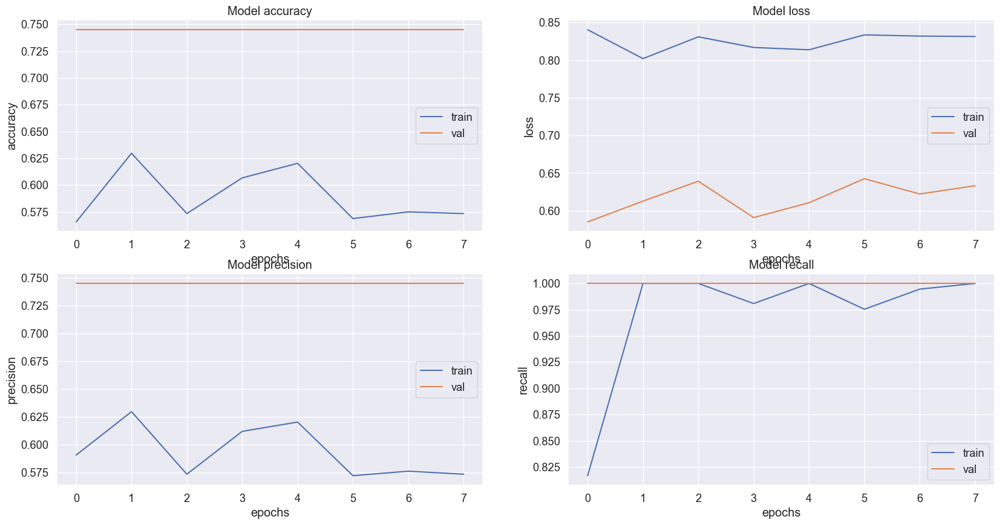

In [319]:
figure, axis = plt.subplots(2, 2, figsize=(20,10))
axis = axis.ravel()

for i,element in enumerate(['accuracy', 'loss','precision','recall']):
    axis[i].plot(efficientenet_model_trained2.history[element])
    axis[i].plot(efficientenet_model_trained2.history['val_' + element])
    axis[i].set_title('Model {}'.format(element))
    axis[i].set_xlabel('epochs')
    axis[i].set_ylabel(element)
    axis[i].legend(['train', 'val'])

In [320]:
efficientenet_model.evaluate(test_generator)

624/624 [==============================] - 117s 156ms/step - loss: 0.6642 - accuracy: 0.6250 - precision: 0.6250 - recall: 1.0000


[0.6641636490821838, 0.625, 0.625, 1.0]

Predicción test

In [ ]:
efficientnet_modelo_importado = tf.keras.models.load_model('modelos/model_efficientnet.h5')

wrong_predicted_image = [[],[]]
correct_predicted_image = [[],[]]
i = 0 # el tamaño de imaganes que tenemos y el len de al lado (en nuestro caso tenemos solamente 624 imagenes en test)
# es hasta las malas que queremos
while i< 624 and len(wrong_predicted_image[0]) < 200:
    j = 0
    while j < 1 and len(wrong_predicted_image[0]) < 200:
        print(i,0,j)
        image_array = (test_generator[i][0][j]).reshape(1,300,300,3)
        
        prediction = efficientnet_modelo_importado.predict(image_array)
        
        if int(round(prediction[0][0])) != test_generator[i][1][j]:
            wrong_predicted_image[0].append(image_array)
            wrong_predicted_image[1].append(int(round(prediction[0][0])))
            
        elif len(correct_predicted_image[0]) < 600: # en caso de que queramos que guarda hasta un numero de correctas 
            correct_predicted_image[0].append(image_array)
            correct_predicted_image[1].append(int(round(prediction[0][0])))
#         print(len(correct_predicted_image[0]),len(wrong_predicted_image[0]))  
        j += 1
        
    i += 1

In [56]:
evaluation_efficient = efficientenet_model.evaluate(test_generator,steps= 624)

624/624 [==============================] - 55s 87ms/step - loss: 1.6394 - accuracy: 0.6667 - precision: 0.6522 - recall: 1.0000


In [57]:
print('loss rate at evaluation data :', evaluation_efficient[0])
print('accuracy rate at evaluation data :', evaluation_efficient[1])
print('precision rate at evaluation data :', evaluation_efficient[2])
print('recall rate at evaluation data :', evaluation_efficient[3])

loss rate at evaluation data : 1.6393872499465942
accuracy rate at evaluation data : 0.6666666865348816
precision rate at evaluation data : 0.6521739363670349
recall rate at evaluation data : 1.0


### MobileNet

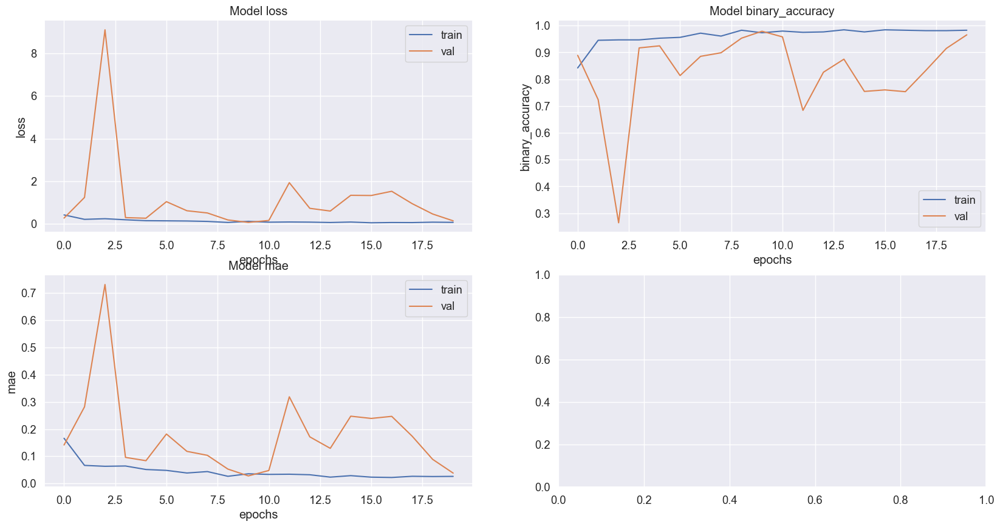

In [326]:
figure, axis = plt.subplots(2, 2, figsize=(20,10))
axis = axis.ravel()

for i,element in enumerate(['loss', 'binary_accuracy','mae']):
    axis[i].plot(model_mobil_trained.history[element])
    axis[i].plot(model_mobil_trained.history['val_' + element])
    axis[i].set_title('Model {}'.format(element))
    axis[i].set_xlabel('epochs')
    axis[i].set_ylabel(element)
    axis[i].legend(['train', 'val'])

In [462]:
model_mobil.evaluate(test_generator)

2023-06-22 22:42:28.972587: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


624/624 [==============================] - 36s 41ms/step - loss: 0.2329 - binary_accuracy: 0.9407 - mae: 0.0714


[0.23293422162532806, 0.9407051205635071, 0.07139717042446136]

In [463]:
model_mobil.save('modelos_entero/mobilenet_0,232_0,940789')

INFO:tensorflow:Assets written to: modelos_entero/mobilenet_0,232_0,940789/assets


INFO:tensorflow:Assets written to: modelos_entero/mobilenet_0,232_0,940789/assets


In [28]:
mobilenetmodelo = tf.keras.models.load_model('modelos_entero/mobilenet_0,232_0,940789')

Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



2023-07-07 13:38:00.609021: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-07 13:38:00.613303: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-07-07 13:38:00.614010: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-07 13:38:00.614398: I tensorflow/core/common_runtime/pluggable_d

In [29]:
prediction_mobil = mobilenetmodelo.predict(test_generator2)

2023-07-07 13:38:30.246148: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


624/624 [==============================] - 13s 19ms/step


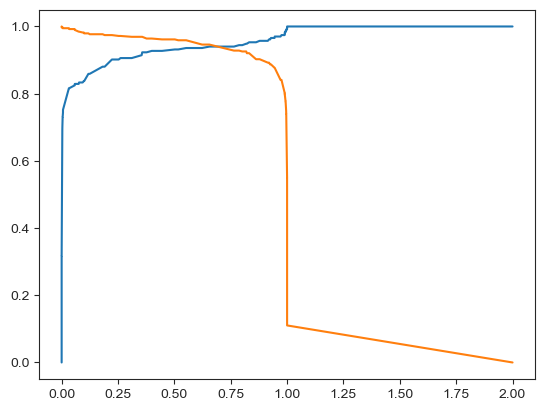

Crossover al 0.66 con especificidad 0.94 y sensibilidad 0.946154


In [30]:
y_true = (test_generator.classes ).astype("int")
fpr, tpr, thresholds = roc_curve(y_true, prediction_mobil)
plt.plot(thresholds, 1.-fpr)
plt.plot(thresholds, tpr)
plt.show()
crossover_index = np.min(np.where(1.-fpr <= tpr))
crossover_cutoff = thresholds[crossover_index]
crossover_specificity = 1.-fpr[crossover_index]
crossover_sensitivity = tpr[crossover_index]
print("Crossover al {0:.2f} con especificidad {1:.2f} y sensibilidad {2:2f}".format(crossover_cutoff, crossover_specificity, crossover_sensitivity))

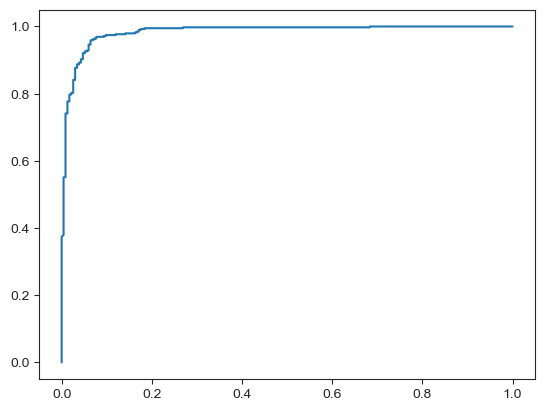

El área bajo la curva ROC es igual a 0.98


In [31]:
plt.plot(fpr, tpr)
plt.show()
print("El área bajo la curva ROC es igual a {0:.2f}".format(roc_auc_score(y_true, prediction_mobil)))

In [499]:
prediction_mobil_crossover = np.where(prediction_mobil > 0.95, np.round(prediction_mobil) , np.round(prediction_mobil-0.5) )

prediction_mobil_crossover_medio = np.where(prediction_mobil > 0.5, np.round(prediction_mobil) , np.round(prediction_mobil) )

confunsion_matriz =  confusion_matrix(test_generator.classes, prediction_mobil_crossover_medio)

In [500]:
confunsion_matriz

array([[218,  16],
       [ 15, 375]])

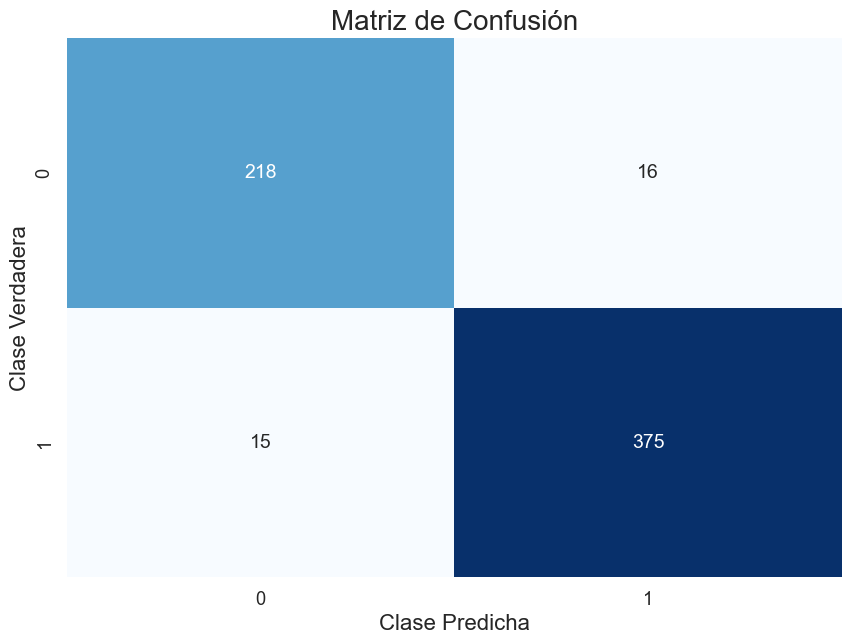

In [501]:
plt.figure(figsize=(10, 7))

# Utilizar Seaborn para crear un heatmap de la matriz de confusión
sns.set(font_scale=1.2)
sns.heatmap(confunsion_matriz, annot=True, fmt='g', cmap='Blues', cbar=False, annot_kws={"size": 14})

# Agregar títulos y etiquetas
plt.title('Matriz de Confusión', fontsize=20)
plt.xlabel('Clase Predicha', fontsize=16)
plt.ylabel('Clase Verdadera', fontsize=16)

# Mostrar la gráfica
plt.show()

In [502]:
print(classification_report(test_generator.classes, prediction_mobil_crossover_medio))

              precision    recall  f1-score   support

           0       0.94      0.93      0.93       234
           1       0.96      0.96      0.96       390

    accuracy                           0.95       624
   macro avg       0.95      0.95      0.95       624
weighted avg       0.95      0.95      0.95       624



In [492]:
#vgg_model_importado = tf.keras.models.load_model('modelos/model_vgg.h5')

wrong_predicted_image = [[],[]]
correct_predicted_image = [[],[]]
i = 0 # el tamaño de imaganes que tenemos y el len de al lado (en nuestro caso tenemos solamente 624 imagenes en test)
# es hasta las malas predichas que queremos
while i< 624 and len(wrong_predicted_image[0]) < 200:
    j = 0
    while j < 1 and len(wrong_predicted_image[0]) <200:
        #print(i,0,j)
        image_array = (test_generator2[i][0][j]).reshape(1,224,224,3)
        
        prediction3 = model_mobil.predict(image_array)
        
        if int(round(prediction3[0][0])) != test_generator2[i][1][j]:
            wrong_predicted_image[0].append(image_array)
            wrong_predicted_image[1].append(int(round(prediction3[0][0])))
            
        elif len(correct_predicted_image[0]) < 600:
            correct_predicted_image[0].append(image_array)
            correct_predicted_image[1].append(int(round(prediction3[0][0])))
#         print(len(correct_predicted_image[0]),len(wrong_predicted_image[0]))  
        j += 1
        
    i += 1

2023-06-22 23:38:52.180291: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 44ms/step


Estudio de interpretabilidad para todos las primeras x imagenes correctamente predichas 

correct_predicted_image --- [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

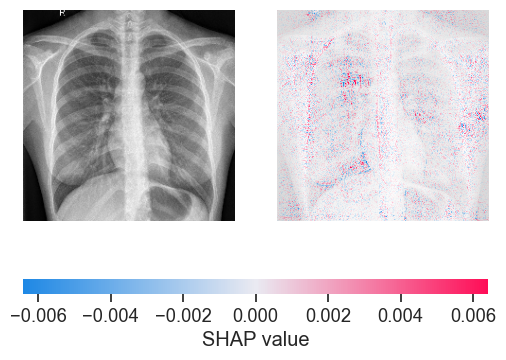

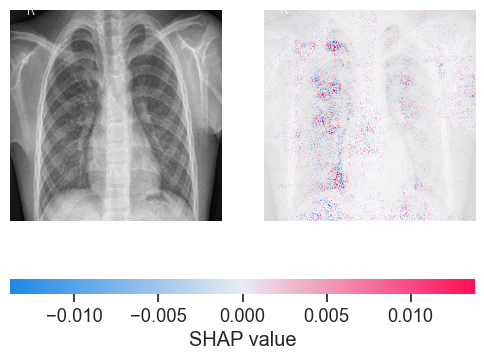

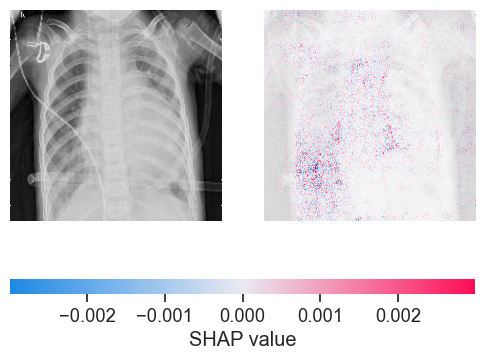

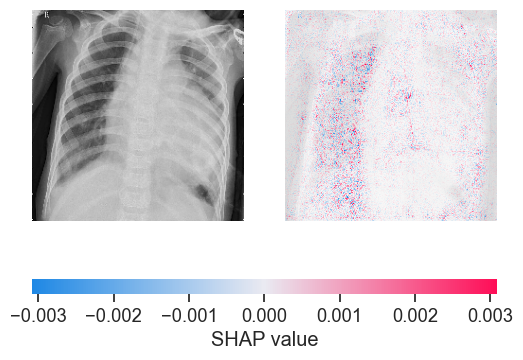

<Figure size 8000x4000 with 0 Axes>

In [562]:
rcParams['figure.figsize'] = 80 ,40

print(f'correct_predicted_image --- {correct_predicted_image[1]}')

for row in range(2):
    for col in range(2):
        index = row * 225 + col  # Índice de la imagen en wrong_predicted_image
        if index < len(correct_predicted_image[0]):
            ele = correct_predicted_image[0][index+10]
            image = tf.keras.preprocessing.image.array_to_img(ele.reshape(224, 224, 3))
            shap_values = explainer.shap_values(correct_predicted_image[0][index+10])
            shap.image_plot(shap_values, correct_predicted_image[0][index+10])
        else:
            # Si no hay suficientes imágenes, se muestra un espacio en blanco
            ax[row][col].axis('off')
plt.tight_layout()
plt.show()

In [ ]:
# Modelo 2

modelo_propio3 = Sequential()

modelo_propio3.add(Conv2D(filters=16, kernel_size=(5, 5), input_shape=(300, 300, 3), activation='relu'))
modelo_propio3.add(MaxPooling2D(pool_size=(3, 3)))

modelo_propio3.add(Conv2D(filters=32, kernel_size=(5, 5), activation='relu'))
#modelo_propio3.add(MaxPooling2D(pool_size=(3, 3)))

modelo_propio3.add(Flatten())
modelo_propio3.add(Dropout(0.2))
modelo_propio3.add(Dense(256, activation='relu'))


modelo_propio3.add(Dense(1, activation='sigmoid'))

modelo_propio3.compile(loss=tf.losses.BinaryCrossentropy(), 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), 
              metrics=['accuracy', tf.keras.metrics.Precision(name='precision'),
        tf.keras.metrics.Recall(name='recall')])


In [560]:
print(prediction_mobil[10])
print(prediction_mobil[11])
print(prediction_mobil[235])
print(prediction_mobil[236])

[2.239651e-08]
[0.00027984]
[0.99999917]
[0.9999969]


correct_predicted_image --- [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

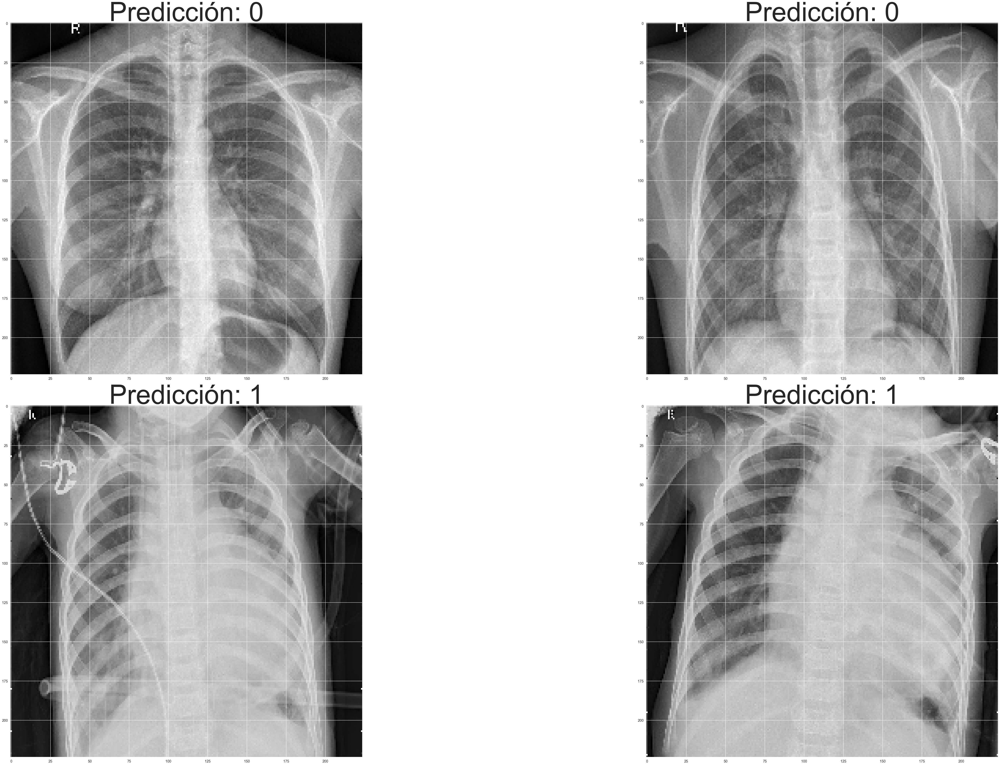

In [565]:
rcParams['figure.figsize'] = 80 ,40

print(f'correct_predicted_image --- {correct_predicted_image[1]}')
fig, ax = plt.subplots(2, 2) # filas y columnas

for row in range(2):
    for col in range(2):
        index = row * 225 + col  # Índice de la imagen en wrong_predicted_image
        if index < len(correct_predicted_image[0]):
            print(index+10)
            ele = correct_predicted_image[0][index+10]
            image = tf.keras.preprocessing.image.array_to_img(ele.reshape(224, 224, 3))
            ax[row][col].imshow(image)
            ax[row][col].set_title('Predicción: 'f'{correct_predicted_image[1][index+10]}', fontsize=100)
        else:
            # Si no hay suficientes imágenes, se muestra un espacio en blanco
            ax[row][col].axis('off')
plt.tight_layout()
plt.show()

wrong_prediction_by_model --- [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


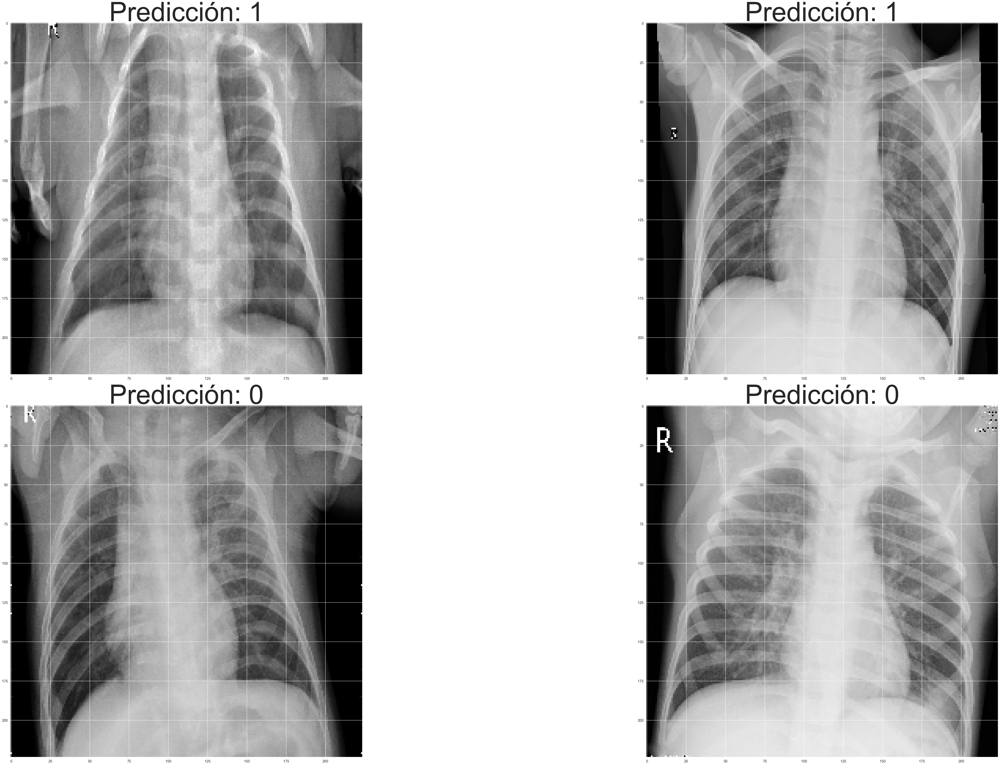

In [564]:
rcParams['figure.figsize'] = 80 ,40

print(f'wrong_prediction_by_model --- {wrong_predicted_image[1]}')
fig, ax = plt.subplots(2, 2) # filas y columnas

for row in range(2):
    for col in range(2):
        index = row * 20 + col  # Índice de la imagen en wrong_predicted_image
        if index < len(wrong_predicted_image[0]):
            ele = wrong_predicted_image[0][index]
            image = tf.keras.preprocessing.image.array_to_img(ele.reshape(224, 224, 3))
            ax[row][col].imshow(image)
            ax[row][col].set_title('Predicción: 'f'{wrong_predicted_image[1][index]}', fontsize=100)
        else:
            # Si no hay suficientes imágenes, se muestra un espacio en blanco
            ax[row][col].axis('off')
plt.tight_layout()
plt.show()

wrong_prediction_by_model --- [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


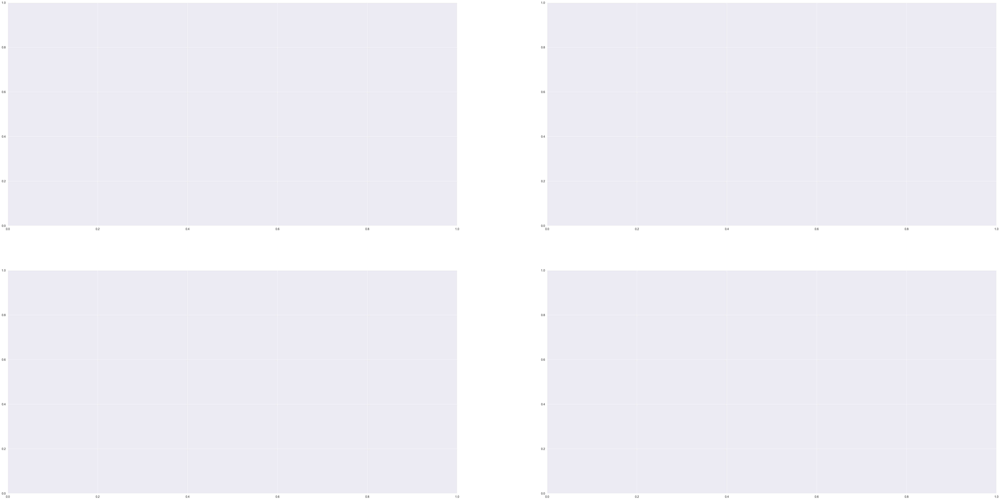

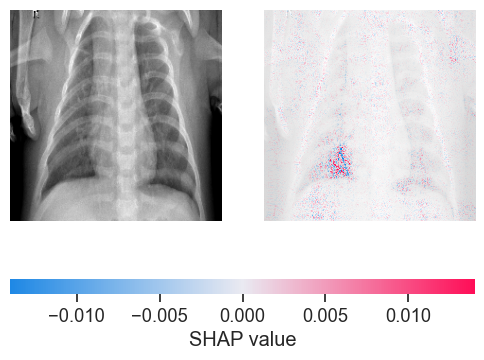

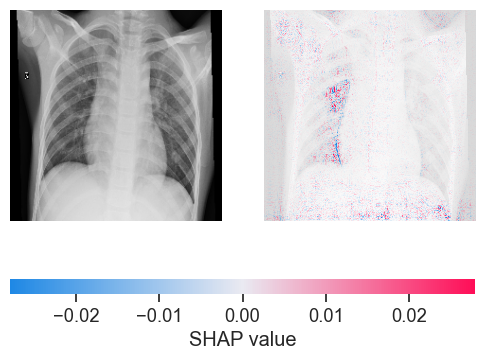

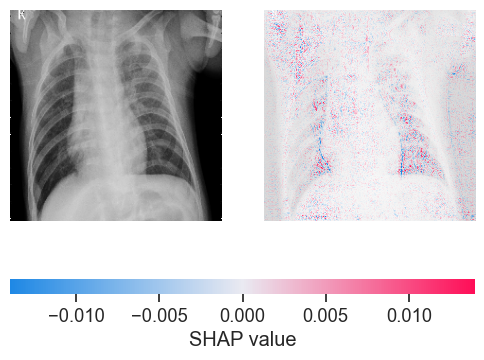

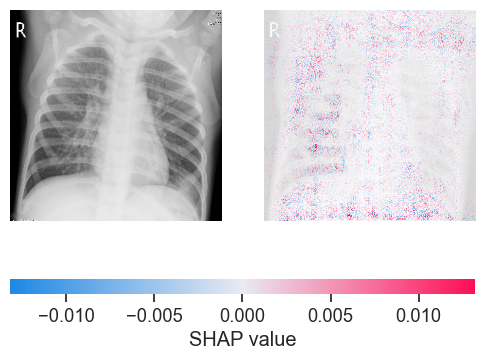

<Figure size 8000x4000 with 0 Axes>

In [516]:
rcParams['figure.figsize'] = 80 ,40

print(f'wrong_prediction_by_model --- {wrong_predicted_image[1]}')
fig, ax = plt.subplots(2, 2) # filas y columnas

for row in range(2):
    for col in range(2):
        index = row * 20 + col  # Índice de la imagen en wrong_predicted_image
        if index < len(wrong_predicted_image[0]):
            ele = wrong_predicted_image[0][index]
            image = tf.keras.preprocessing.image.array_to_img(ele.reshape(224, 224, 3))
            shap_values = explainer.shap_values(wrong_predicted_image[0][index])
            shap.image_plot(shap_values, wrong_predicted_image[0][index])
            #ax[row][col].imshow(image)
            #ax[row][col].set_title('Etiqueta: 'f'{wrong_predicted_image[1][index]}', fontsize=100)
        else:
            # Si no hay suficientes imágenes, se muestra un espacio en blanco
            ax[row][col].axis('off')
plt.tight_layout()
plt.show()

In [494]:
len(wrong_predicted_image[1])

31

In [ ]:
for i, buenos in enumerate(wrong_predicted_image[0]):
    image = tf.keras.preprocessing.image.array_to_img(buenos.reshape(224,224,3))
    plt.imshow(image)
    plt.axis('off')  # Para ocultar los ejes
    
    # Agregar título con la etiqueta correspondiente
    etiqueta = wrong_predicted_image[1][i]
    plt.title(f'Etiqueta predicha: {etiqueta}', fontsize=10)
    
    plt.show()